In [ ]:
#! /app/software/R/4.0.3-foss-2020b/bin/Rscript
## JG used R/4.1.2-foss-2020b

# load external dependencies
lmod <- Sys.getenv("LMOD_CMD")
modules <- c(
    #"cairo/1.16.0-GCCcore-10.2.0",
    "R/4.1.2-foss-2020b",
    #"X11/20201008-GCCcore-10.2.0",
    "MACS2/2.2.6-foss-2019b-Python-3.7.4")

for (module in modules) {
    cmd <- paste(lmod, 'R', 'load', module)
    code <- system(cmd, intern = TRUE)
    eval(parse(text = code))
}

In [ ]:
Sys.unsetenv("DISPLAY")

suppressPackageStartupMessages({
    library(ArchR)
    library(parallel)
    library(rtracklayer)
    library(repr)
    library(dplyr)
    library(Seurat)
    library(plyr)
    library(ComplexHeatmap)
    library(RColorBrewer)    
    library(BSgenome.Hsapiens.UCSC.hg38)
    library(raincloudplots)
    library(PupillometryR)
    library(cowplot)
    library(scales) 
})
set.seed(1)

# Set default plot size
options(repr.plot.width=10, repr.plot.height=10)

In [ ]:
addArchRThreads(threads = 24)

Input threads is equal to or greater than ncores minus 1 (23)
Setting cores to ncores minus 2. Set force = TRUE to set above this number!

Setting default number of Parallel threads to 22.



In [ ]:
#Utility functions
# SVD, UMAP, and Clustering
UMAP_clusters = function(proj){
    #SVD
    proj <- addIterativeLSI(
        ArchRProj = proj,
        useMatrix = "TileMatrix", 
        name = "IterativeLSI", 
        iterations = 2, 
        dimsToUse = 1:45, 
        varFeatures = 200000, 
        clusterParams = list( #See Seurat::FindClusters,
            resolution = c(0.1, 0.3), 
            sampleCells = 8000, 
            n.start = 10), 
        outlierQuantiles = c(0.025, 0.975), 
        verbose = FALSE,
        force=TRUE
    )
    #UMAP
    proj <- addUMAP(
        ArchRProj = proj,
        reducedDims = "IterativeLSI",
        name = "UMAP",
        nNeighbors = 40,
        minDist = 0.4,
        metric = "cosine",
        verbose = FALSE,
        force = TRUE
    )
    #Clustering
    #proj <- addClusters(input = proj, 
    #                        method = "Seurat", 
    #                        name = "Clusters", 
    #                        reducedDims = "IterativeLSI",  
    #                        resolution = 0.3, 
    #                        #maxClusters = 100,
    #                        verbose = FALSE,
    #                        force=TRUE
    #                       )
    
    #Save
    #p1 <- plotEmbedding(ArchRProj = proj, colorBy = "cellColData", name = "Clusters", embedding = "UMAP")
    #plotPDF(p1, name = "Plot-UMAP-Sample-Clusters_1.pdf", ArchRProj = proj, addDOC = FALSE, width = 5, height = 5)
    return(proj)
}

In [ ]:
#compute gene scores, impute genes

impute_genes = function(proj){
    # Gene scores with selected features
    # Artificial black list to exclude all non variable features
    #chrs <- getChromSizes(proj)
    #var_features_gr <- GRanges(var_features$seqnames,
    #                           IRanges(var_features$start,
    #                                   var_features$start + bin_size))
    #blacklist <- setdiff(chrs, var_features_gr)
    proj <- addGeneScoreMatrix(proj, matrixName='GeneScoreMatrix', force=TRUE) 
    
    #impute
    proj = addImputeWeights(      
    ArchRProj = proj,
    reducedDims = "IterativeLSI",
    dimsToUse = 1:10,
    scaleDims = NULL,
    corCutOff = 0.75,
    td = 3,
    ka = 4,
    sampleCells = 3000,
    nRep = 5,
    k = 15,
    epsilon = 1,
    useHdf5 = TRUE,
    randomSuffix = FALSE,
    threads = getArchRThreads(),
    seed = 1,
    verbose = TRUE,
    logFile = createLogFile("addImputeWeights")
    )
     return(proj)
}

In [ ]:
#load data
proj_name = 'DJ_Hs_PBMC_K27me3_220523_220527_79x79_MERGE_50k'
version = 'proj_FINAL'
proj_dir <- paste0("/fh/fast/henikoff_s/user/jgreene/projects/sciCnT/data/ArchR/", proj_name, '/', version)
proj = loadArchRProject(path = proj_dir,
                 force = TRUE,
                 showLogo = TRUE)
setwd(proj_dir)

Successfully loaded ArchRProject!


                                                   / |
                                                 /    \
            .                                  /      |.
            \\\                              /        |.
              \\\                          /           `|.
                \\\                      /              |.
                  \                    /                |\
                  \\#####\           /                  ||
                ==###########>      /                   ||
                 \\##==......\    /                     ||
            ______ =       =|__ /__                     ||      \\\
        ,--' ,----`-,__ ___/'  --,-`-===================##========>
       \               '        ##_______ _____ ,--,__,=##,__   ///
        ,    __==    ___,-,__,--'#'  ==='      `-'    | ##,-/
        -,____,---'       \\####\\________________,--\\_##,/
           ___      .______        ______  __    __  .____

In [ ]:
proj


           ___      .______        ______  __    __  .______      
          /   \     |   _  \      /      ||  |  |  | |   _  \     
         /  ^  \    |  |_)  |    |  ,----'|  |__|  | |  |_)  |    
        /  /_\  \   |      /     |  |     |   __   | |      /     
       /  _____  \  |  |\  \\___ |  `----.|  |  |  | |  |\  \\___.
      /__/     \__\ | _| `._____| \______||__|  |__| | _| `._____|
    



class: ArchRProject 
outputDirectory: /fh/fast/henikoff_s/user/jgreene/projects/sciCnT/data/ArchR/DJ_Hs_PBMC_K27me3_220523_220527_79x79_MERGE_50k/proj_FINAL 
samples(1): DJ_Hs_PBMC_K27me3_ALLSEQ_220523_220527
sampleColData names(1): ArrowFiles
cellColData names(30): Sample TSSEnrichment ... FRIP annotation1
numberOfCells(1): 14984
medianTSS(1): 1.411
medianFrags(1): 2116

In [ ]:
median(proj$nFrags)

[1] 2116

ArchR logging to : ArchRLogs/ArchR-plotEmbedding-5b23596ab7d6-Date-2022-12-30_Time-11-31-36.log
If there is an issue, please report to github with logFile!

Getting UMAP Embedding

ColorBy = cellColData

Plotting Embedding

1 


ArchR logging successful to : ArchRLogs/ArchR-plotEmbedding-5b23596ab7d6-Date-2022-12-30_Time-11-31-36.log



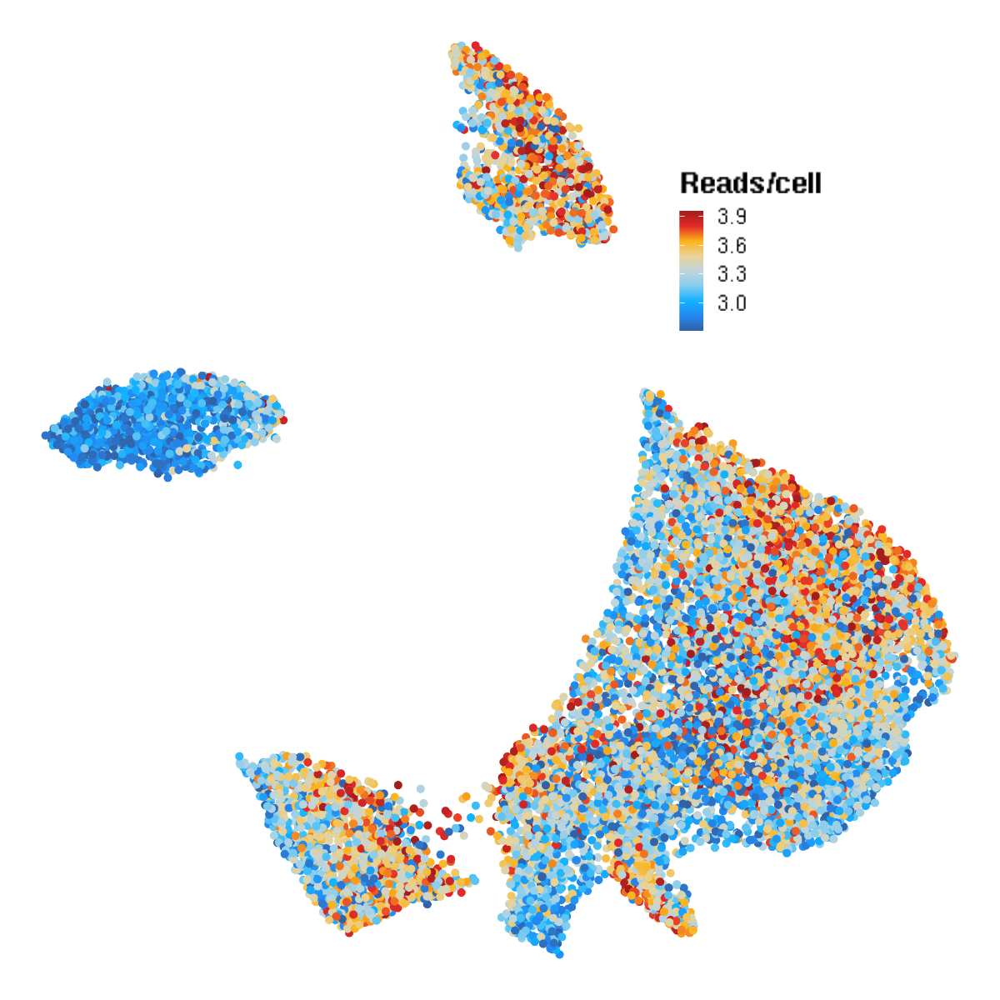

In [ ]:
#Visualize clusters
proj$logFrags = log10(proj$nFrags)
p0 = plotEmbedding(ArchRProj = proj, colorBy = "cellColData", 
              name = "logFrags", 
              embedding = "UMAP", 
              size =1, 
              #pal= c("3"="black","2"="#f77e05", "1"="#b50202"),
              plotAs= "points", 
              #imputeWeights = getImputeWeights(proj)
              colorTitle = 'Reads/cell'
             )+theme_void()+theme(plot.title = element_blank(), 
                                  strip.text = element_blank(), 
                                  legend.position = c(.75, .75), 
                                  legend.text = element_text(size=15, family = 'Helvetica'),
                                  legend.title = element_text(size=20, family = 'Helvetica', face = "bold")
                                 )#+NoLegend()
p0

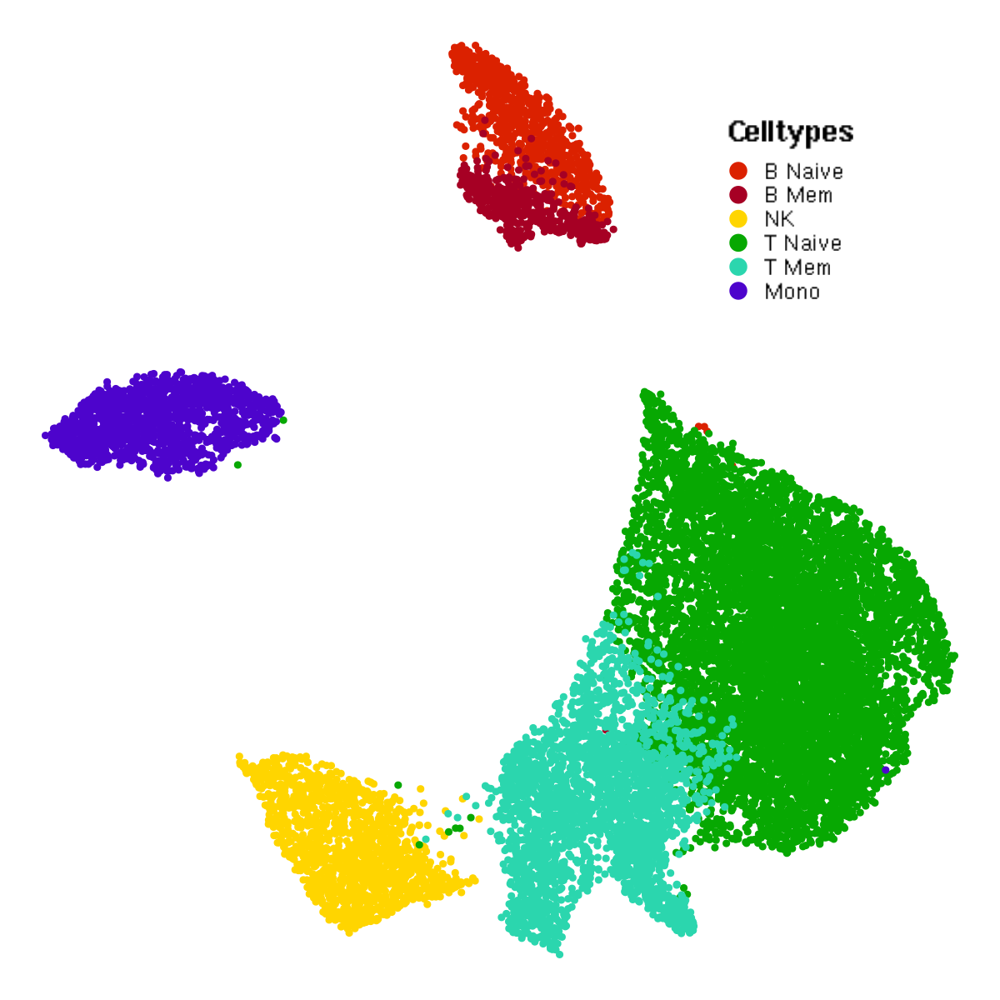

In [7]:
#Annotation

#extract umap
umap_df = proj@cellColData %>% data.frame()
umap_df$UMAP_1 = proj@embeddings$UMAP$df[,1]
umap_df$UMAP_2 = proj@embeddings$UMAP$df[,2]

#reorder and plot
ord_new = c( 'B Naive','B Mem','NK', 'T Naive','T Mem', 'Mono')
umap_df$Clusters <- factor(umap_df$annotation1, levels = ord_new)
umap_df <- umap_df[order(umap_df$Clusters),]

plot0 = ggplot(umap_df, aes(x = UMAP_1, 
                    y = UMAP_2, 
                    color = Clusters)
    )+geom_point(position = "jitter"
    )+theme_void(
    )+theme(legend.position = c(.79, .79), 
            legend.text = element_text(size=15, family = 'Helvetica'),
            legend.title = element_text(size=20, family = 'Helvetica', face = "bold")
    )+guides(color = guide_legend(override.aes = list(size = 5))
    )+scale_color_manual(name = "Celltypes",
                         values = c(#B
                                     "#db2100", 
                                    "#a60024",
                                    #NK
                                    "#ffd500",
                                    #T
                                    "#07a802",
                                    #"#139c90",
                                    #"#c5eb7a", 
                                    "#2bd6ae",
                                     #Mono
                                    #'#b23dd9',
                                    "#4d04cc")
                        )
plot0

In [93]:
plot_dir = '/fh/fast/henikoff_s/user/jgreene/projects/sciCnT/data/Figures/500bp/'
pdf(file=paste0(plot_dir, '221220_PBMC_K27me3_45dims_counts_legend.pdf'),width=10, height=10)
p0
dev.off()

png 
  2

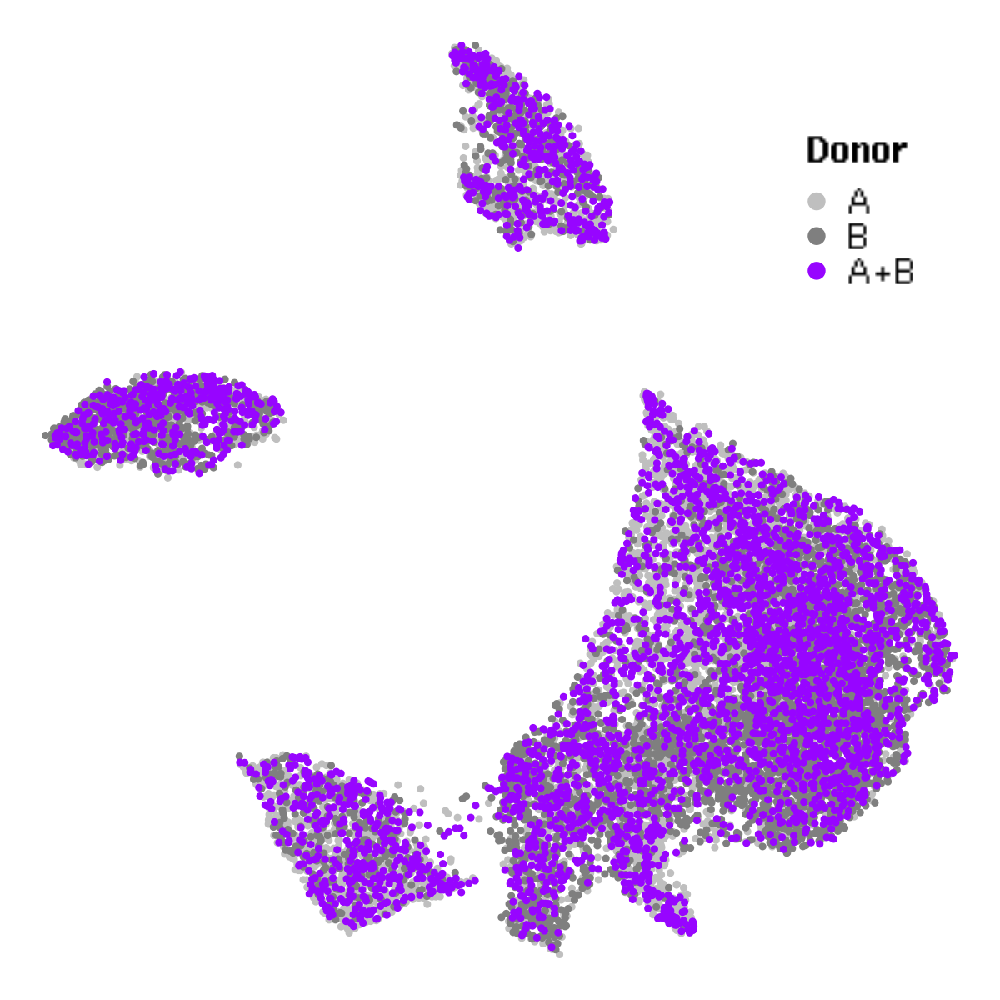

In [11]:
#extract umap
umap_df = proj@cellColData %>% data.frame()
umap_df$UMAP_1 = proj@embeddings$UMAP$df[,1]
umap_df$UMAP_2 = proj@embeddings$UMAP$df[,2]

#reorder and plot
ord_new = c('A','B','A+B')
umap_df$Donor <- factor(umap_df$Donor, levels = ord_new)
umap_df <- umap_df[order(umap_df$Donor),]

ggplot(umap_df, aes(x = UMAP_1, 
                    y = UMAP_2, 
                    color = Donor)
    )+geom_point(
    )+theme_void(
    )+theme(plot.title = element_blank(), 
            strip.text = element_blank(), 
            legend.position = c(.86, .79), 
            legend.text = element_text(size=25),# face = "bold"),
            legend.title = element_text(size=25, face = "bold")
    )+guides(color = guide_legend(override.aes = list(size = 5))
    )+scale_color_manual(name = "Donor",
                         values = c('#bfbfbf', '#7f7f7f', '#9705ff'
                                   )
)

In [75]:
library('raincloudplots')
library('PupillometryR')
library('cowplot')
library('scales') 

Loading required package: rlang


Attaching package: ‘rlang’


The following object is masked from ‘package:magrittr’:

    set_names


The following object is masked from ‘package:data.table’:

    :=


The following object is masked from ‘package:Biobase’:

    exprs




In [13]:
options(repr.plot.width=15, repr.plot.height=10)

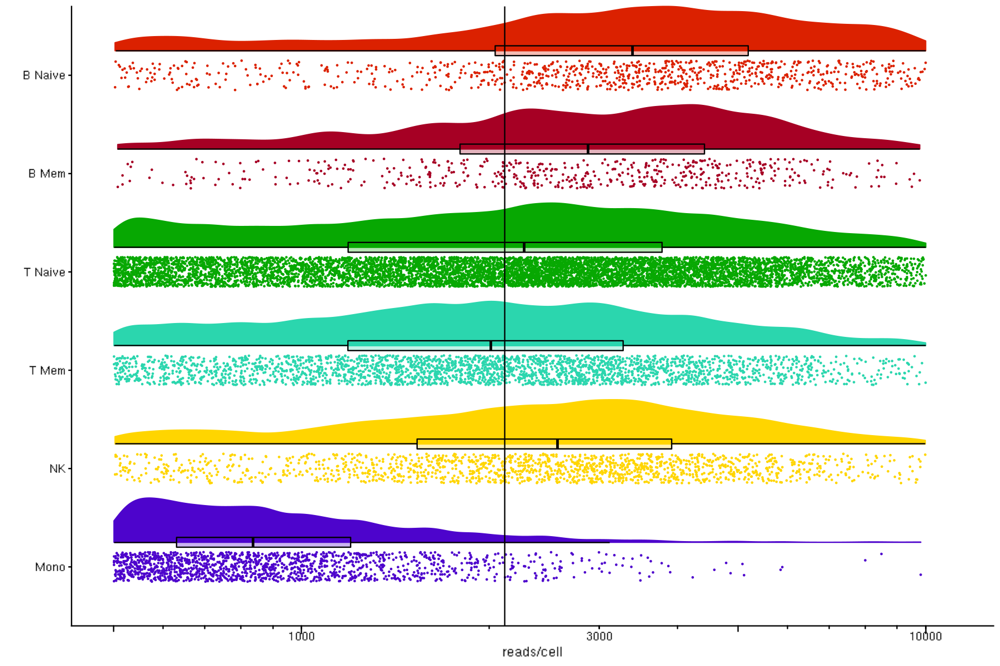

In [15]:
#Rainclouds with mean and confidence interval
pal = c(#B
    "#db2100", 
    "#a60024",
    #T
    "#07a802",
    #"#139c90",
    #"#c5eb7a", 
    "#2bd6ae",
    #NK
    "#ffd500",
     #Mono
    #'#b23dd9',
    "#4d04cc")
#extract umap
umap_df = proj@cellColData %>% data.frame()
umap_df$UMAP_1 = proj@embeddings$UMAP$df[,1]
umap_df$UMAP_2 = proj@embeddings$UMAP$df[,2]

#reorder and plot
ord_new = c( 'B Naive','B Mem', 'T Naive','T Mem','NK', 'Mono')
umap_df$Clusters <- factor(umap_df$annotation1, levels = rev(ord_new))
umap_df <- umap_df[order(umap_df$Clusters),]

p7 <- ggplot(umap_df,
             aes(x=Clusters,
                 y=nFrags, 
                 fill = Clusters, 
                 colour = Clusters
                )
            )+
    geom_flat_violin(
        position = position_nudge(
        x = .25, 
        y = 0),
        adjust =.5,
        scale = "width"
    )+
    geom_point(position = position_jitter(width = .15), 
             size = .25)+
    geom_boxplot(aes(x = Clusters, 
                     y = nFrags),
                 position = position_nudge(
                        x = .25, 
                        y = 0),
                 outlier.shape = NA, 
                 alpha = 0.3, 
                 width = .1, 
                 colour = "BLACK") +

    geom_hline(yintercept = median(umap_df$nFrags), color = 'black')+
    ylab('reads/cell')+
    xlab('')+
    coord_flip(clip = "off")+
    theme_cowplot()+
    guides(fill = 'none', 
           colour = 'none')+
    scale_color_manual(name = "Celltypes",
                         values = rev(pal)
    )+
    scale_fill_manual(name = "Celltypes",
                         values = rev(pal)
    )+
    scale_y_log10(limits = c(500, 11000))+ 
    scale_x_discrete()+
    annotation_logticks(sides = 'b', outside = T,)
p7

In [16]:
plot_dir = '/fh/fast/henikoff_s/user/jgreene/projects/sciCnT/data/Figures/'
pdf(file=paste0(plot_dir, '221216_PBMC_K27me3_rainplot.pdf'),width=15, height=10)
p7
dev.off()

png 
  2

# Genes

In [12]:
proj1 <- addGeneScoreMatrix(proj1, matrixName='GeneScoreMatrix', force=TRUE) 

ArchR logging to : ArchRLogs/ArchR-addGeneScoreMatrix-903c87e6d7-Date-2022-10-05_Time-17-28-03.log
If there is an issue, please report to github with logFile!

2022-10-05 17:28:03 : Batch Execution w/ safelapply!, 0 mins elapsed.

.createArrowGroup : Arrow Group already exists! Dropping Group from ArrowFile! This will take ~10-30 seconds!

.dropGroupsFromArrow : Initializing Temp ArrowFile

.dropGroupsFromArrow : Adding Metadata to Temp ArrowFile

.dropGroupsFromArrow : Adding SubGroups to Temp ArrowFile

.dropGroupsFromArrow : Move Temp ArrowFile to ArrowFile

DJ_Hs_PBMC_K27me3_ALLSEQ_220523_220527 .addGeneScoreMat useTSS = FALSE

2022-10-05 17:28:18 : Computing Gene Scores using distance relative to GeneBody! , 0.246 mins elapsed.

ArchR logging successful to : ArchRLogs/ArchR-addGeneScoreMatrix-903c87e6d7-Date-2022-10-05_Time-17-28-03.log



In [8]:
#impute
proj = addImputeWeights(      
ArchRProj = proj,
reducedDims = "IterativeLSI",
dimsToUse = 1:15,
scaleDims = NULL,
corCutOff = 0.75,
td = 3,
ka = 4,
sampleCells = 3000,
nRep = 5,
k = 15,
epsilon = 1,
useHdf5 = TRUE,
randomSuffix = FALSE,
threads = getArchRThreads(),
seed = 1,
verbose = TRUE,
logFile = createLogFile("addImputeWeights")
)

ArchR logging to : ArchRLogs/ArchR-addImputeWeights-5b233cad10fa-Date-2022-12-30_Time-11-37-12.log
If there is an issue, please report to github with logFile!

2022-12-30 11:37:12 : Computing Impute Weights Using Magic (Cell 2018), 0 mins elapsed.

Warning message in sprintf("Completed Getting Magic Weights!", round(object.size(weightList)/10^9, :
“one argument not used by format 'Completed Getting Magic Weights!'”


In [9]:
#marker genes
markersGS <- getMarkerFeatures(
ArchRProj = proj, 
useMatrix = "GeneScoreMatrix", 
groupBy = 'annotation1',
bias = c("log10(nFrags)"),
testMethod = "wilcoxon"
)

ArchR logging to : ArchRLogs/ArchR-getMarkerFeatures-5b235652f0ca-Date-2022-12-30_Time-11-37-26.log
If there is an issue, please report to github with logFile!

MatrixClass = Sparse.Double.Matrix

2022-12-30 11:37:27 : Matching Known Biases, 0.005 mins elapsed.

###########
2022-12-30 11:38:01 : Completed Pairwise Tests, 0.584 mins elapsed.
###########

ArchR logging successful to : ArchRLogs/ArchR-getMarkerFeatures-5b235652f0ca-Date-2022-12-30_Time-11-37-26.log



In [17]:
#Visualize clusters
p = plotEmbedding(
        ArchRProj = proj, 
        colorBy = "GeneScoreMatrix", 
        name = fin, 
        embedding = "UMAP",
        quantCut = c(0.01, 0.95),
        size =1, 
        pal= paletteContinuous(), 
        plotAs= "points", 
        imputeWeights = getImputeWeights(proj)
)

Getting ImputeWeights

ArchR logging to : ArchRLogs/ArchR-plotEmbedding-5b233bd419b6-Date-2022-12-30_Time-11-41-37.log
If there is an issue, please report to github with logFile!

Getting UMAP Embedding

ColorBy = GeneScoreMatrix

Getting Matrix Values...

2022-12-30 11:41:38 : 

1 


Imputing Matrix

Using weights on disk

Using weights on disk

Using weights on disk

Using weights on disk

Using weights on disk

Plotting Embedding

1 
2 
3 
4 
5 
6 
7 
8 
9 
10 
11 
12 
13 
14 
15 
16 
17 
18 
19 


ArchR logging successful to : ArchRLogs/ArchR-plotEmbedding-5b233bd419b6-Date-2022-12-30_Time-11-41-37.log



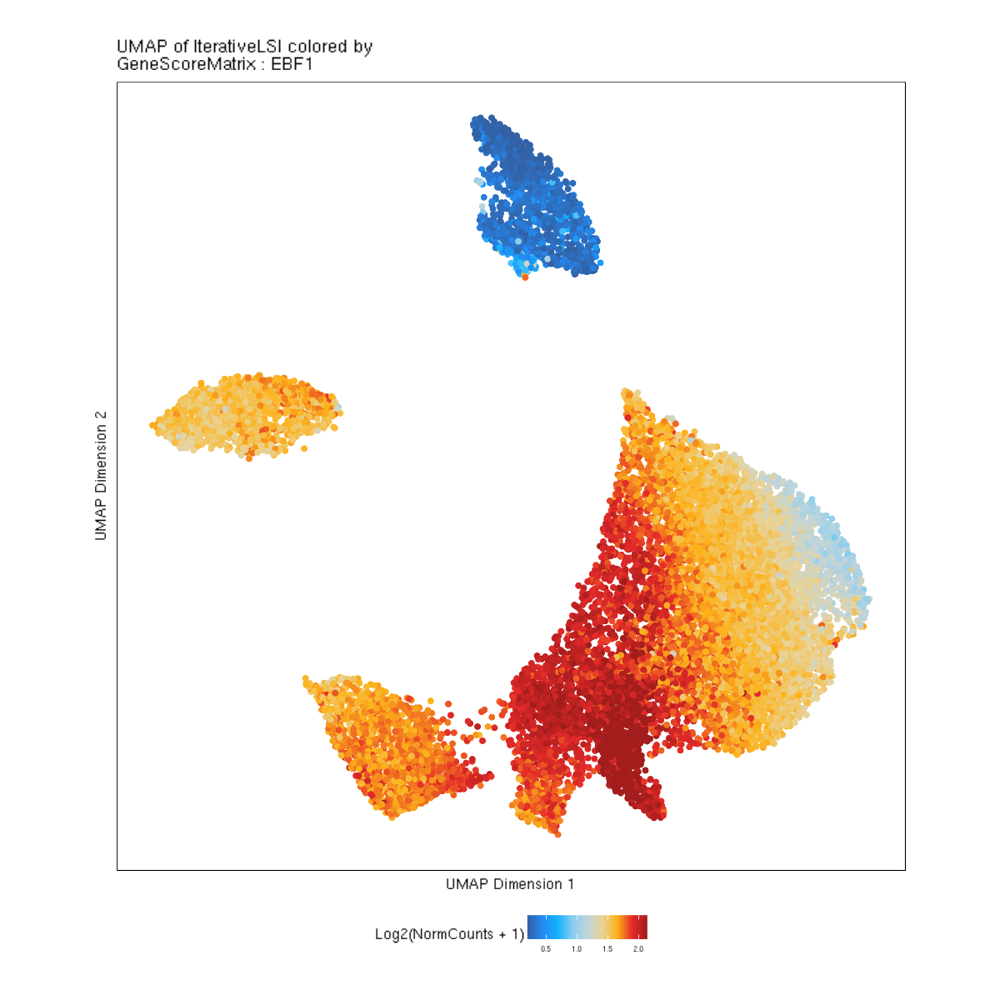

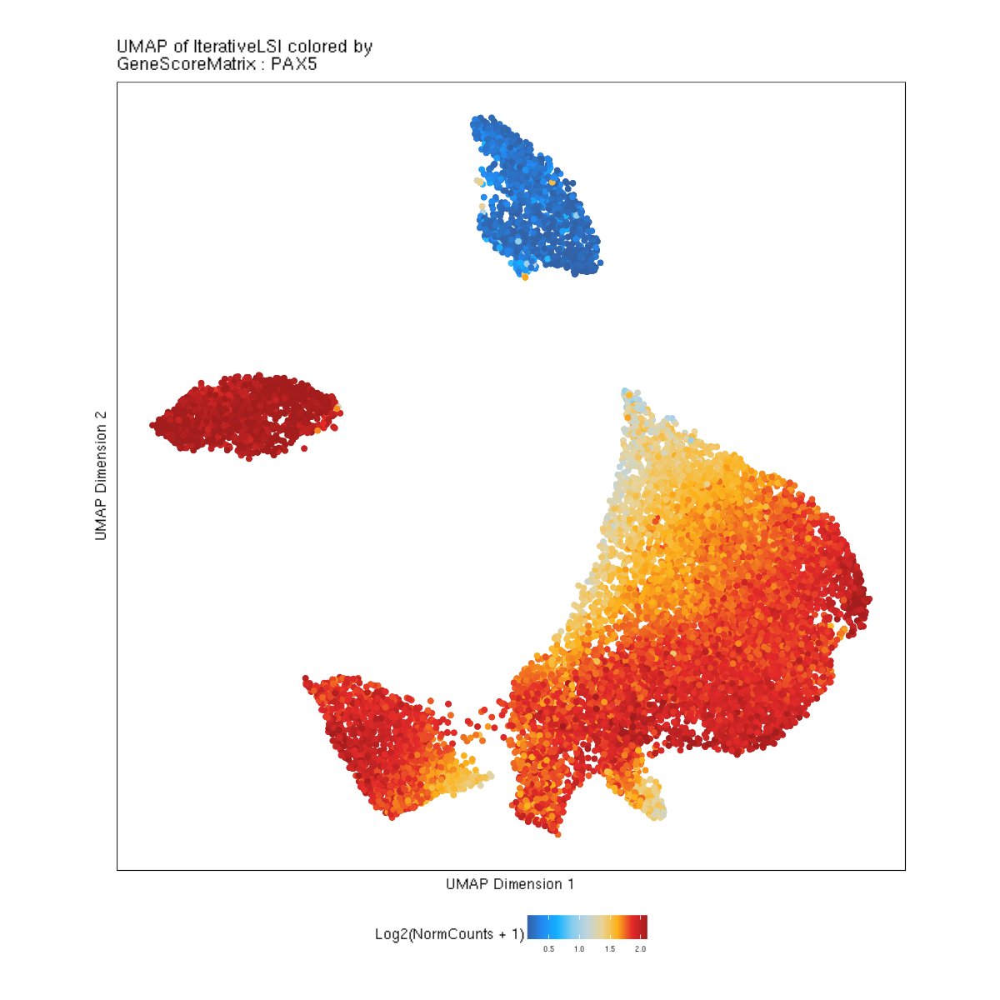

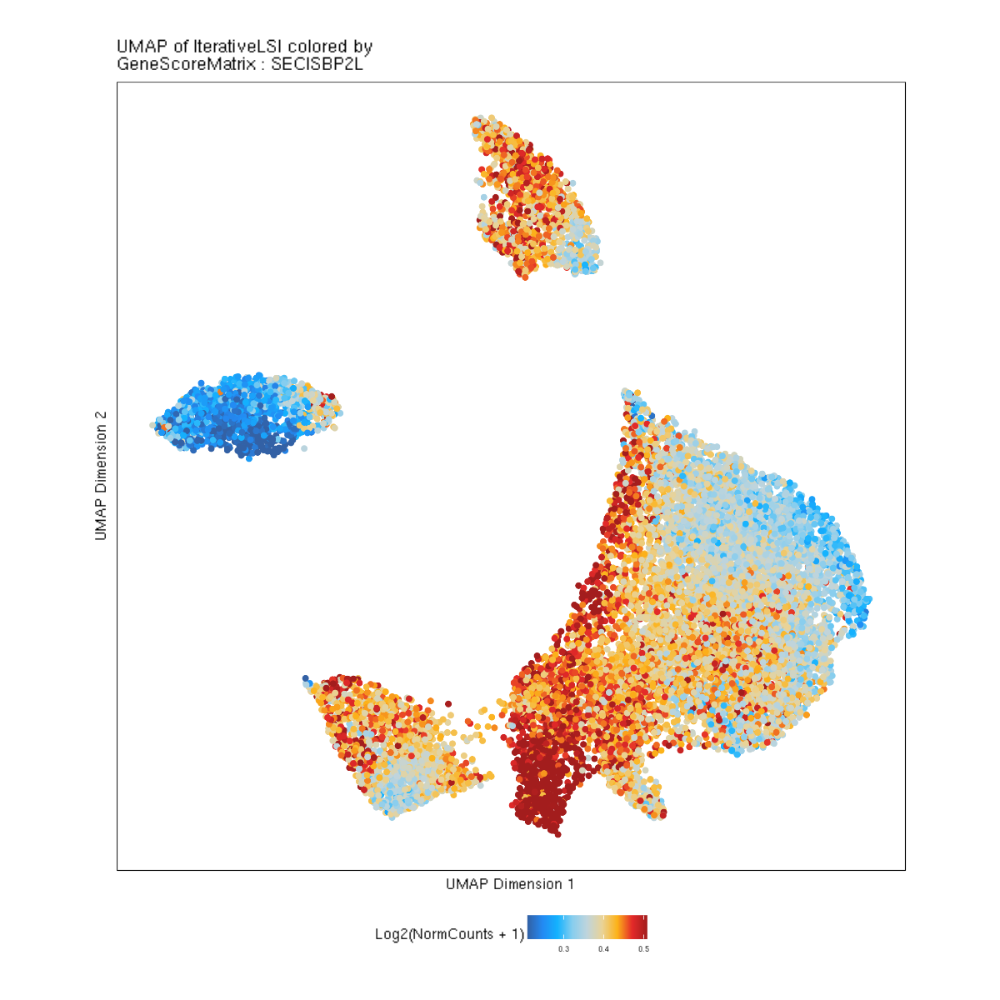

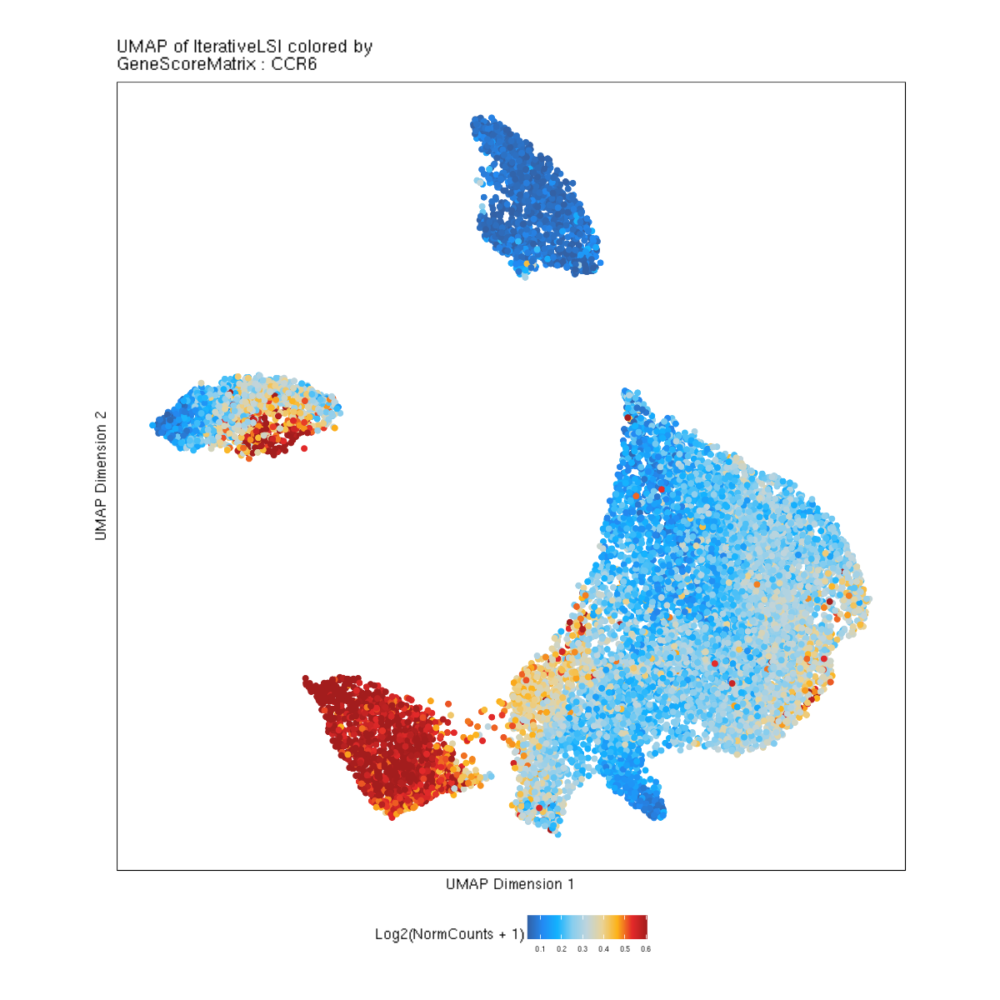

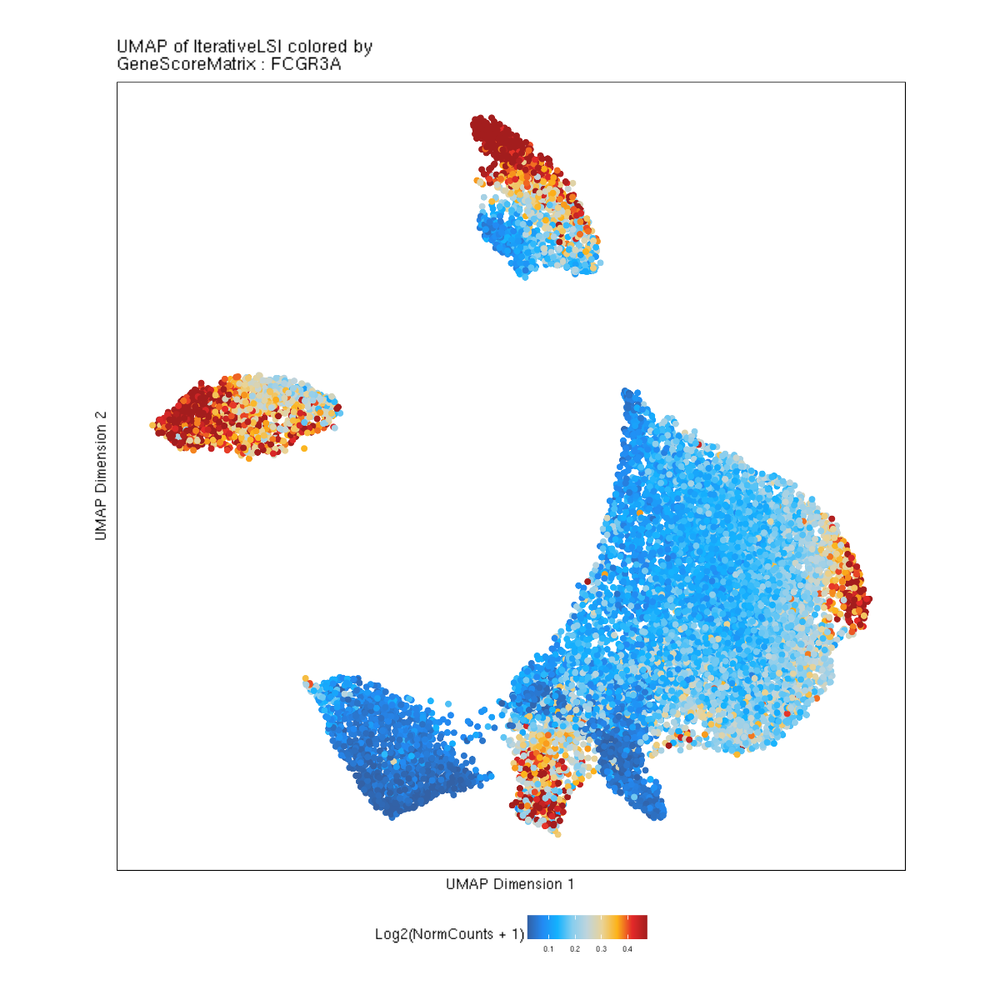

...

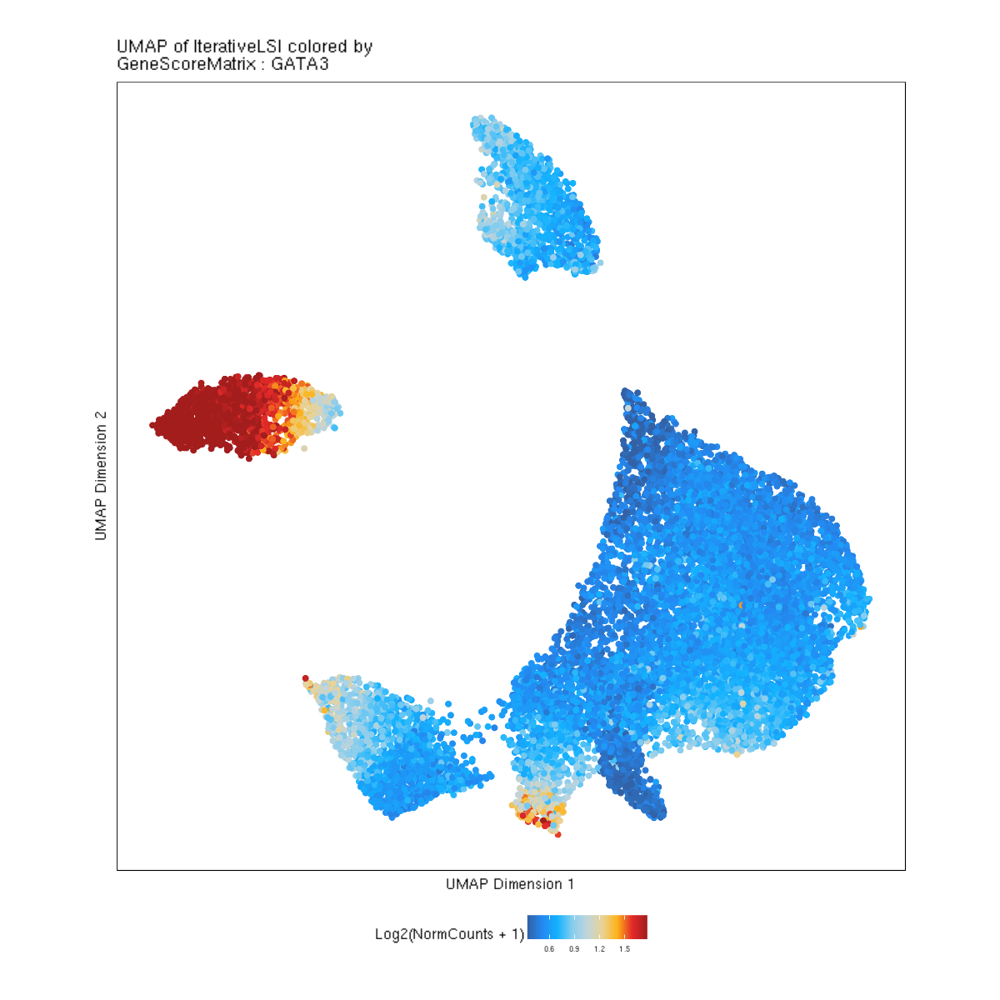

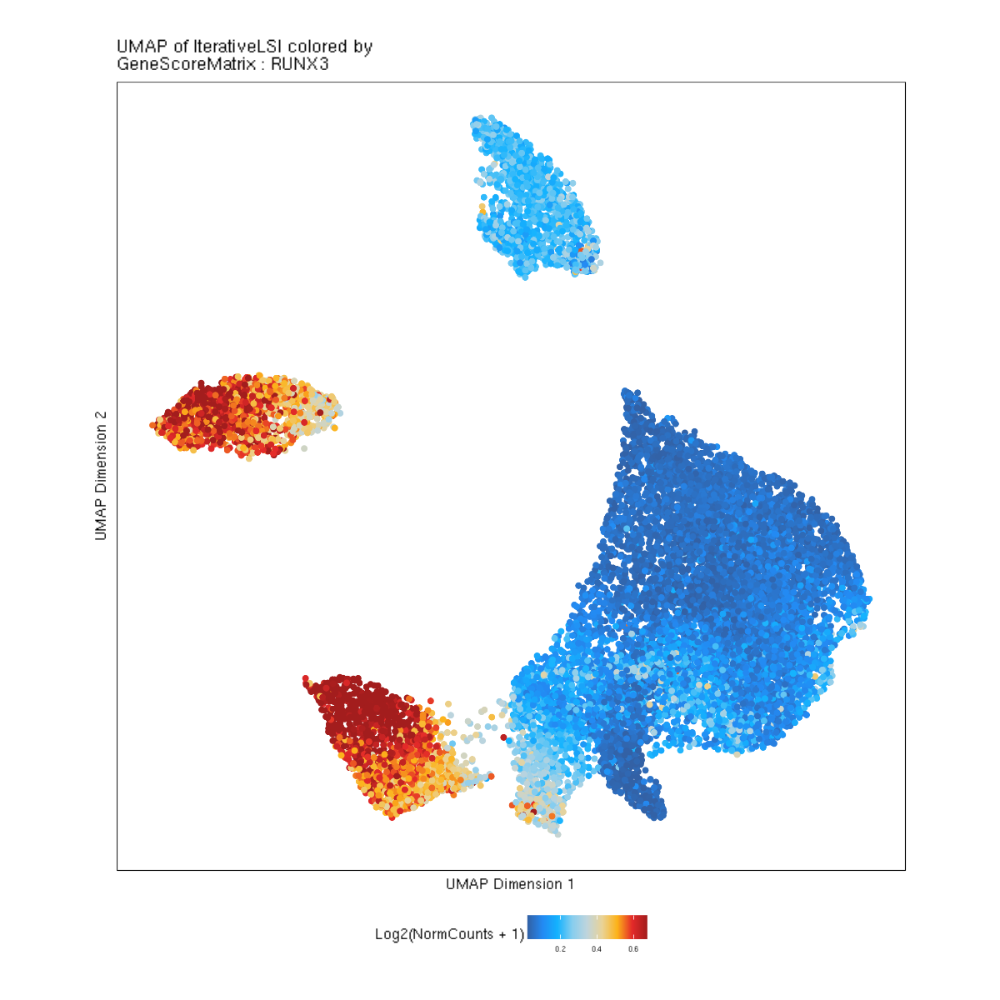

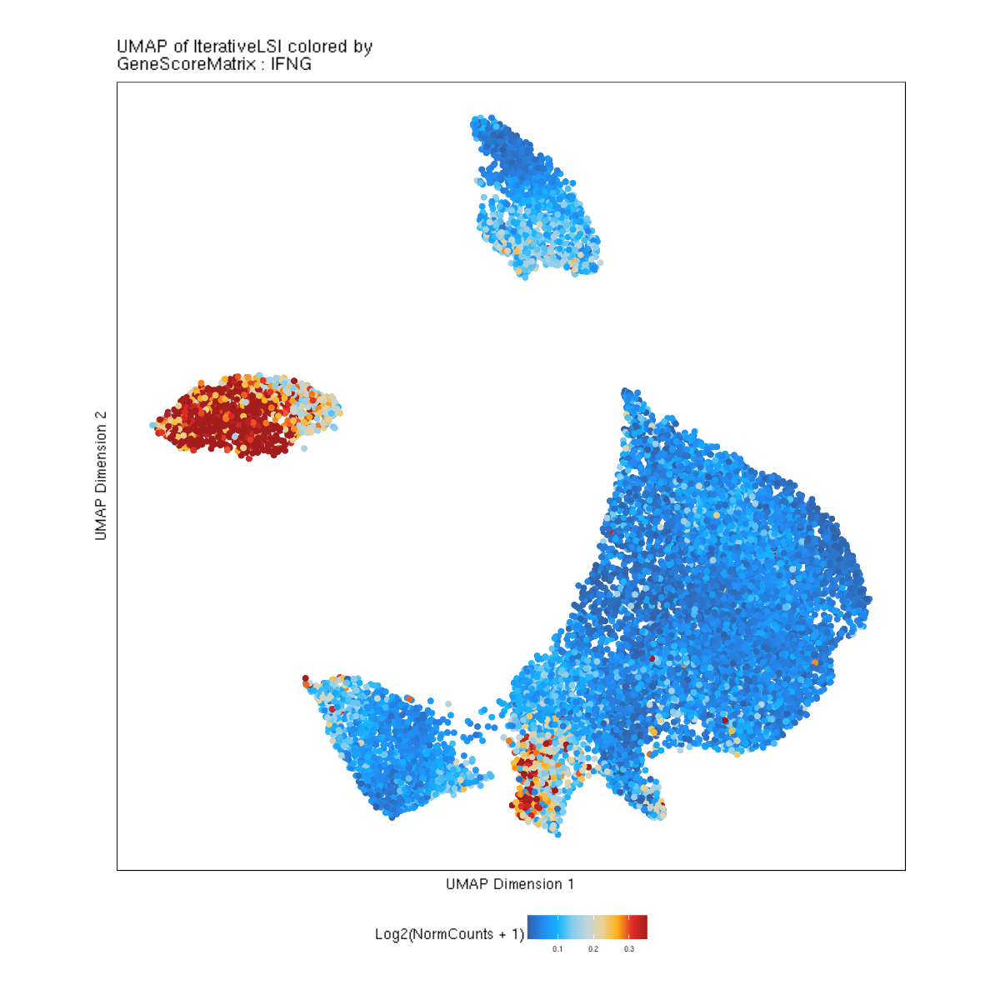

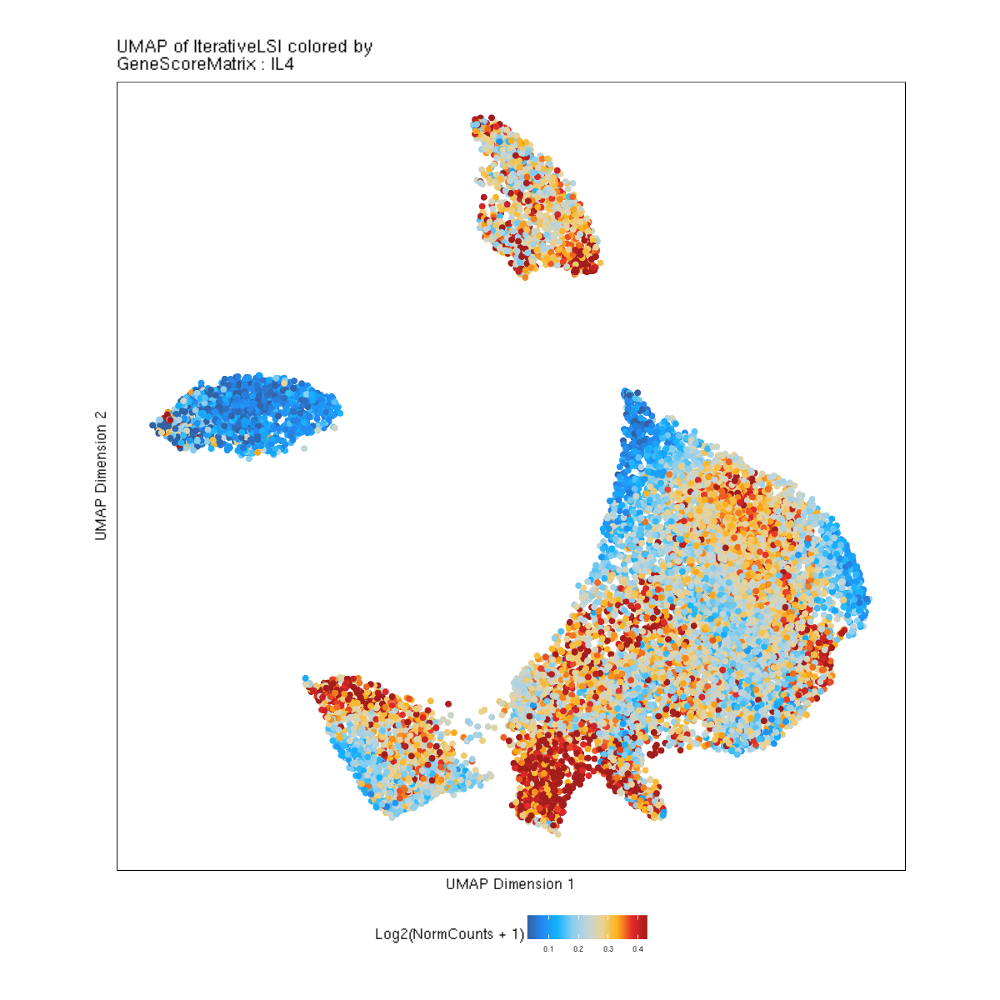

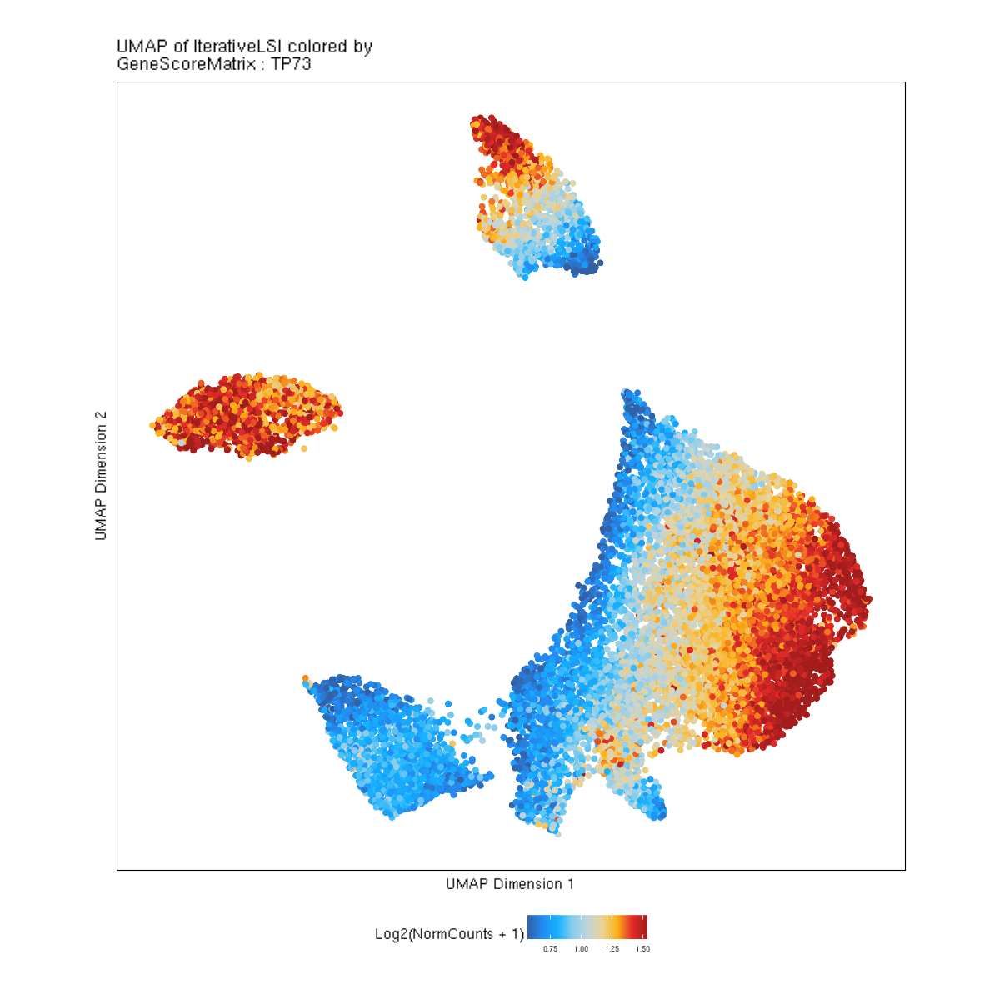

$EBF1

$PAX5

$SECISBP2L

$CCR6

$FCGR3A

$CEBPA

$CEBPB

$LEF1

$CD4

$CD8A

$CD3D

$TBX21

$GATA3

$RUNX3

$IFNG

$IL4

$TP73

$NCAM1

$NCAM2


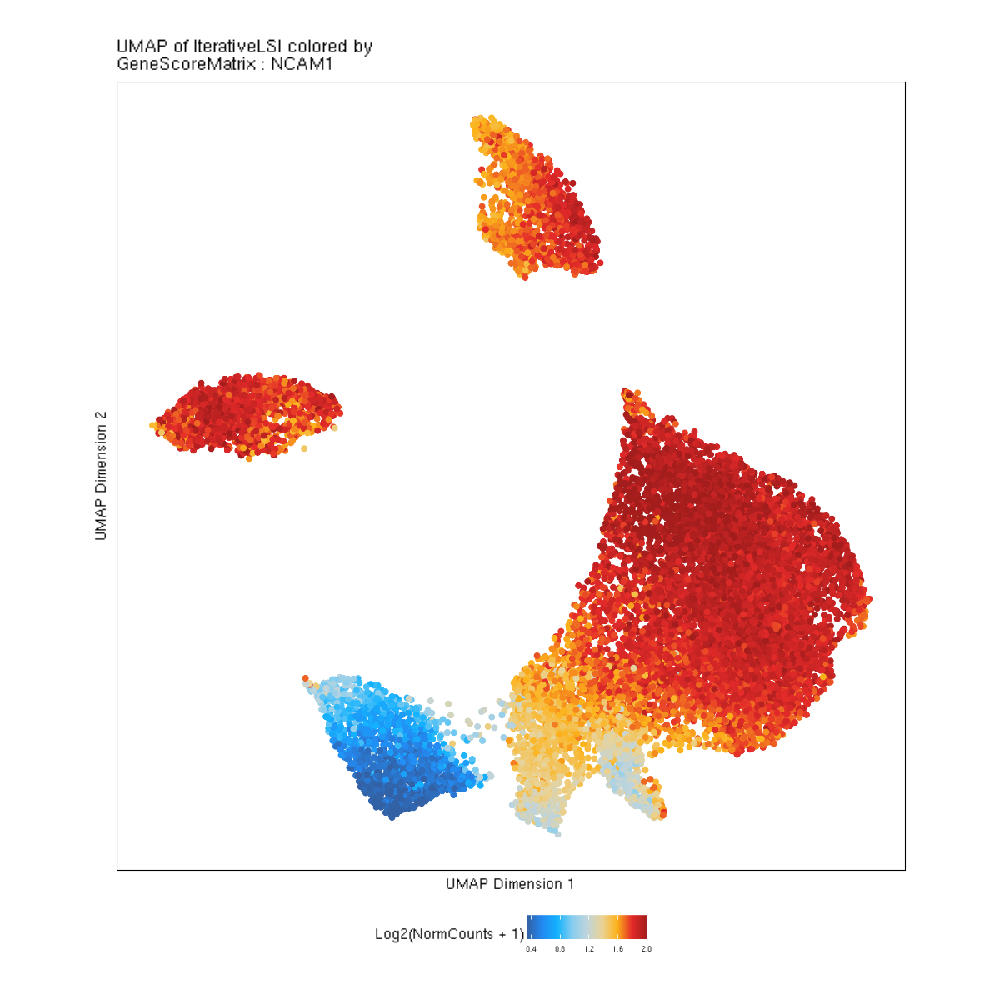

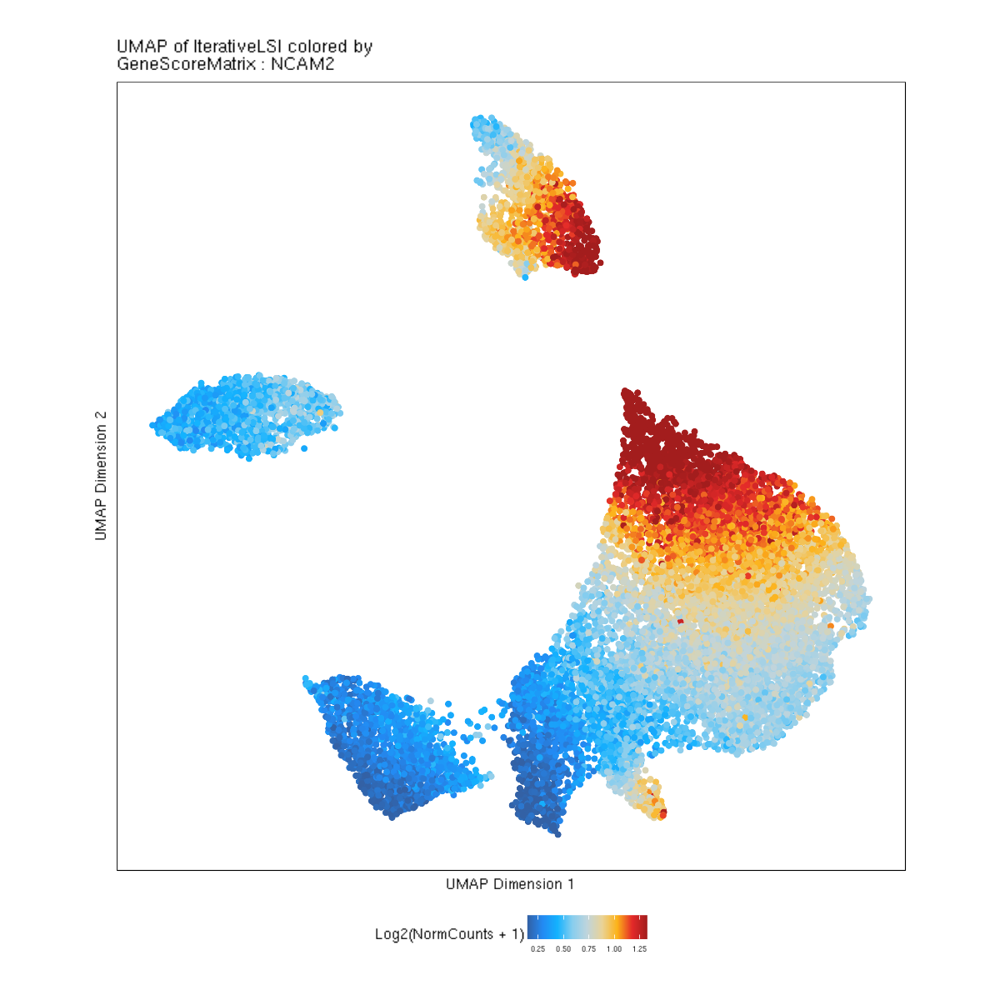

In [18]:
p

In [11]:
markerGenes  <- c(
    "PAX5", "EBF1",'PRDM1', #B Cell Trajectory
    "CEPBA", "CEBPB", "SECISBP2L", "FCGR3A", "CD14", #Monocytes
    "CD3D", "CD8A", "CD4",'LEF1', #T Cells Naive
    'TOX', 'PDCD1', 'TBX21', 'RUNX3', 'BACH2', 'TIM3', 'PD1', 'CTLA4', # T Cell Mem
    'ITGAX', 'FLT3', 'KLRD1', 'NCAM1', 'NCAM2' #NK

    
    ## CD34 progenitors
    #"CD34","CD38","PTPRC", "KIT", "FLT3", "HMGB3", "IL3RA", "IL7R", "MME", "CD27", "BCR", "ABL1",
    ## CD33 myeloid progenitors
   # "CD34", "CD33","KIT","CD68", "NECTIN2", "FLT3", "CSF3R",
    ## B-cells
   # "CD19", "MS4A1", "HLA-DRB1", "FCGR3A", "CD27", "IGheavy1", "CD9", "CD58", "PRDM2",
    ## Plasma Cells
   # "ENPP1", "CD38", "SDC1", "CD27",
    ## T-cells
    #"CD2", "CD3D", "NCAM1", "IL2RA", "CD69", "CD5", "CD4", "CD8A", "CD40LG",           
    #"CD4", "CD8A","IL7R", "CCR7", "TCF7", "GZMK", "CTLA4", "TIGIT", "TBX21", "GATA3", "RORA", "FOXP3",
    ## NK-cells
    #"CD3D", "NCAM1", "FCGR3A"
    ## dendritic cells
   # "CD1C", "CD83", "THBD", "CD209", "HLA-DRB1", "ITGAX", "IL3RA", "CLEC4C", "NRP1",
    ## platelets, should be no platelets 
    #"GP1BA", "SELP",
    ## Macrophages
    #"ITGAM", "CD68", "CD163", "ANPEP",
    ## Monocytes
    #"CD14", "FCGR3A", "FCGR1A",
    ## Red Blood Cells and erythroblast
    #"ST6GALNAC1", "TFRC", "SLC4A1", "GYPA", "GYPB", "RHD", "RHCE", "RHAG", "HBB",
    ## Neutrophiles
    #"FUT4", "FCGR3A", "CEACAM8", "CEACAM3",
    ## Basophils/Eosinophils
    #"IL3RA", "ENPP3", "FCER1A", "ITGAM", "CCR3", "ADGRE1", "SIGLEC8",
    ##Endothelial
    #"CD36", "CD93", "PECAM1", "VCAM1", "CDH5", "ESAM"
  )

In [13]:
## CD34 progenitors
CD34_genes = c("CD34","CD38","PTPRC", "KIT", "FLT3", "HMGB3", "IL3RA", "IL7R", "MME", "CD27", "BCR", "ABL1")
## CD33 myeloid progenitors
MyProg_genes = c("CD34", "CD33","KIT","CD68", "NECTIN2", "FLT3", "CSF3R")
## B-cells
B_genes = c("CD19", "MS4A1", "HLA-DRB1", "FCGR3A", "CD27", "IGheavy1", "CD9", "CD58")
## Plasma Cells
Plasma_genes = c("ENPP1", "CD38", "SDC1", "CD27")
## T-cells
T_genes = c("CD2", "CD3D", "NCAM1", "IL2RA", "CD69", "CD5", "CD4", "CD8A", "CD40LG")           
T_genes2 = c("CD4", "CD8A","IL7R", "CCR7", "TCF7", "GZMK", "CTLA4", "TIGIT", "TBX21", "GATA3", "RORA", "FOXP3")
## NK-cells
NK_genes = c("CD3D", "NCAM1", "FCGR3A")
## dendritic cells
DC_genes = c("CD1C", "CD83", "THBD", "CD209", "HLA-DRB1", "ITGAX", "IL3RA", "CLEC4C", "NRP1")
## platelets, should be no platelets 
Plate_genes = c("GP1BA", "SELP")
## Macrophages
Mac_Genes = c("ITGAM", "CD68", "CD163", "ANPEP")
## Monocytes
Mono_genes = c("CD14", "FCGR3A", "FCGR1A")
## Red Blood Cells and erythroblast
RBC_genes = c("ST6GALNAC1", "TFRC", "SLC4A1", "GYPA", "GYPB", "RHD", "RHCE", "RHAG", "HBB")
## Neutrophiles
Neutro_genes = c("FUT4", "FCGR3A", "CEACAM8", "CEACAM3")
## Basophils/Eosinophils
BasoEo_genes = c("IL3RA", "ENPP3", "FCER1A", "ITGAM", "CCR3", "ADGRE1", "SIGLEC8")
##Endothelial
Endo_genes = c("CD36", "CD93", "PECAM1", "VCAM1", "CDH5", "ESAM")

#Final markers
fin = c("EBF1", "PAX5", #B
        "SECISBP2L", "CCR6","FCGR3A", 'CEBPA', 'CEBPB', #M
        "LEF1", "CD4", "CD8A", "CD3D", "TBX21", "GATA3", 'RUNX3', 'IFNG', 'IL4', 'TP73', #T
        "NCAM1", "NCAM2" #NK
       )

ArchR logging to : ArchRLogs/ArchR-plotEmbedding-698913cafbd-Date-2022-10-05_Time-14-09-36.log
If there is an issue, please report to github with logFile!

Getting UMAP Embedding

ColorBy = GeneScoreMatrix

Getting Matrix Values...

2022-10-05 14:09:38 : 

1 


Plotting Embedding

1 
2 
3 
4 
5 
6 
7 
8 
9 
10 
11 
12 
13 
14 
15 
16 
17 
18 


ArchR logging successful to : ArchRLogs/ArchR-plotEmbedding-698913cafbd-Date-2022-10-05_Time-14-09-36.log



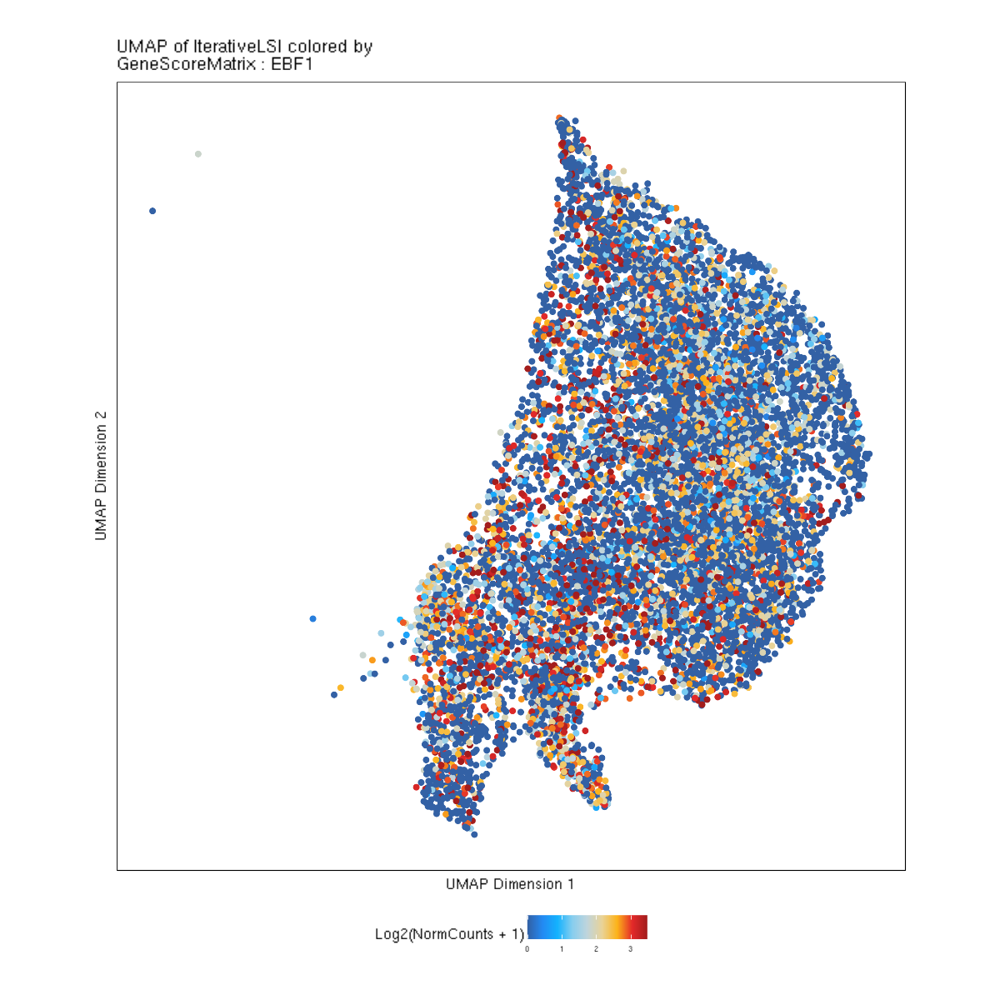

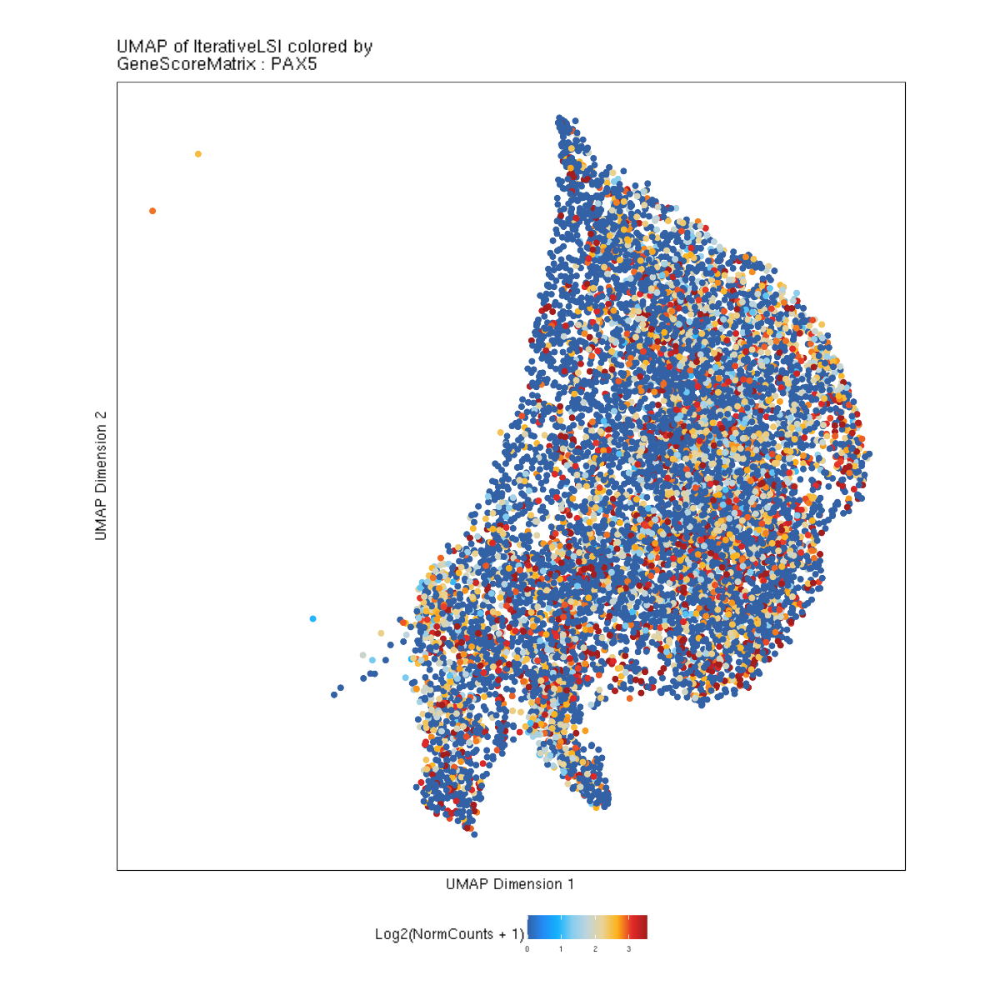

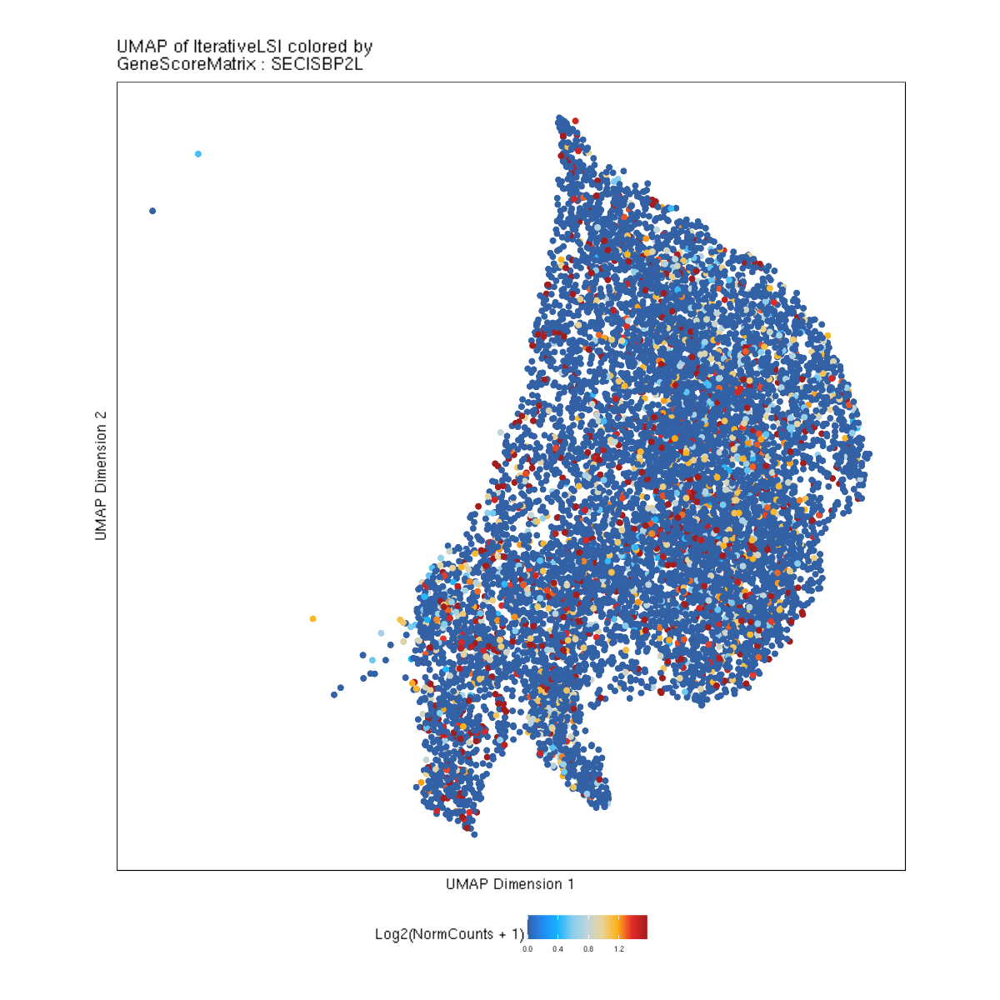

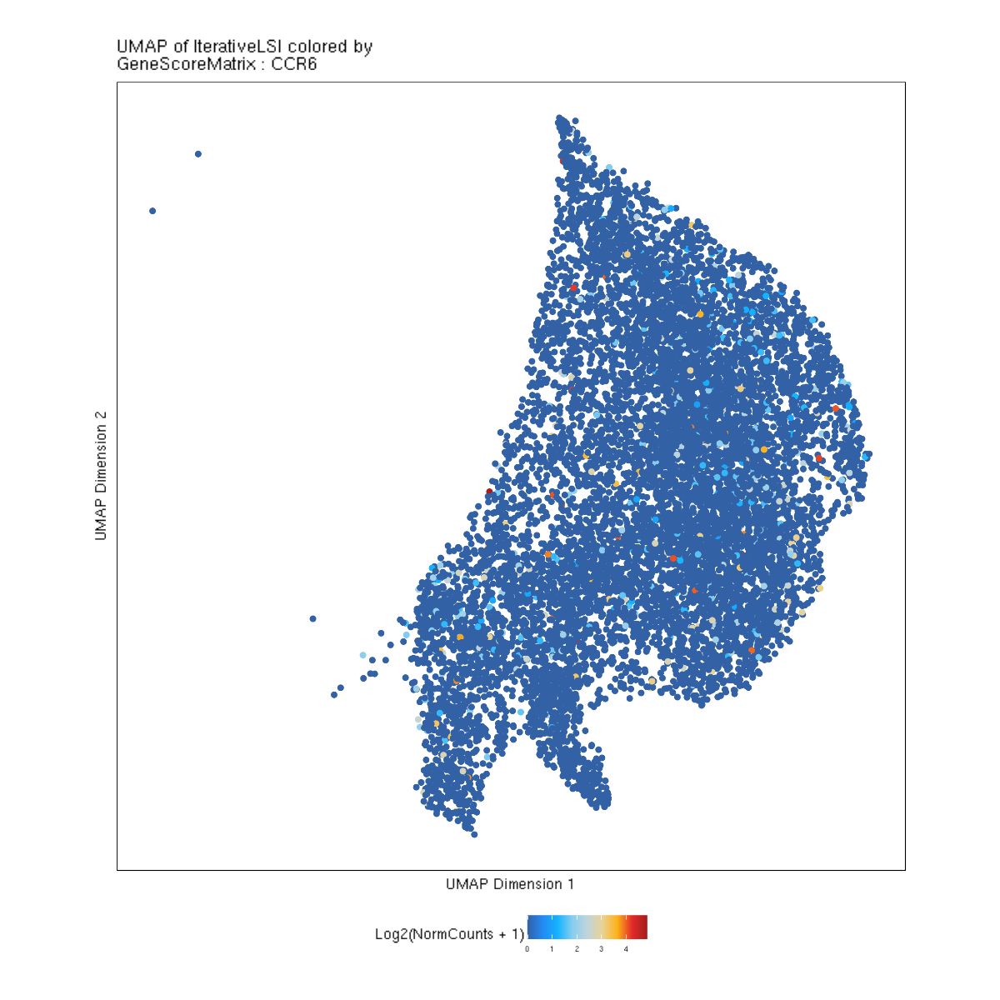

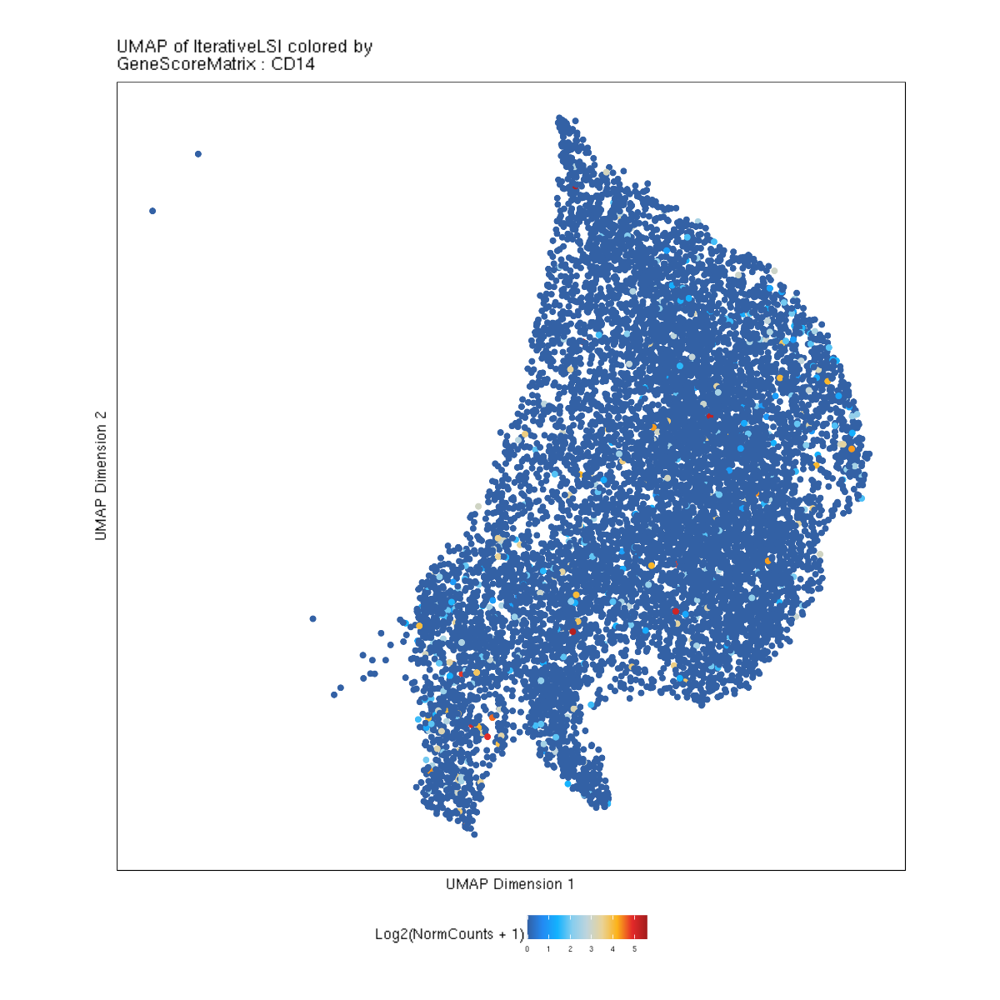

...

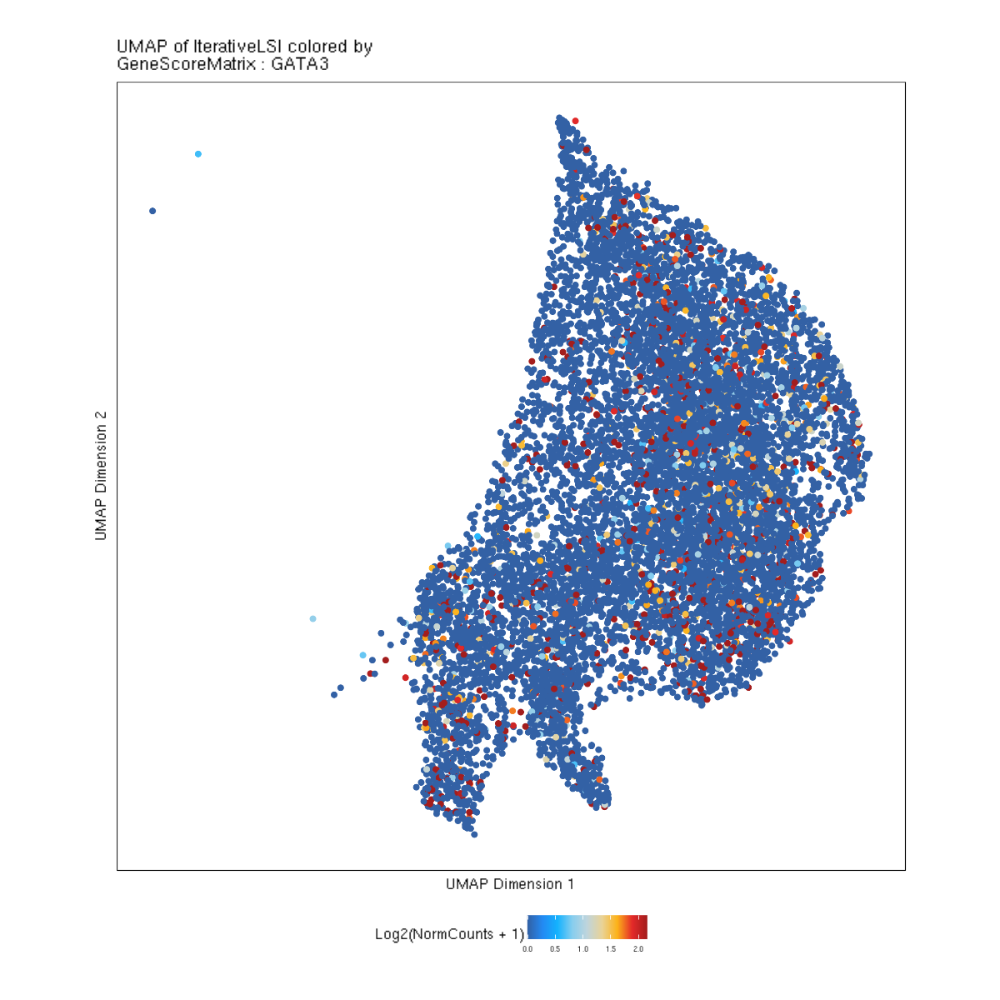

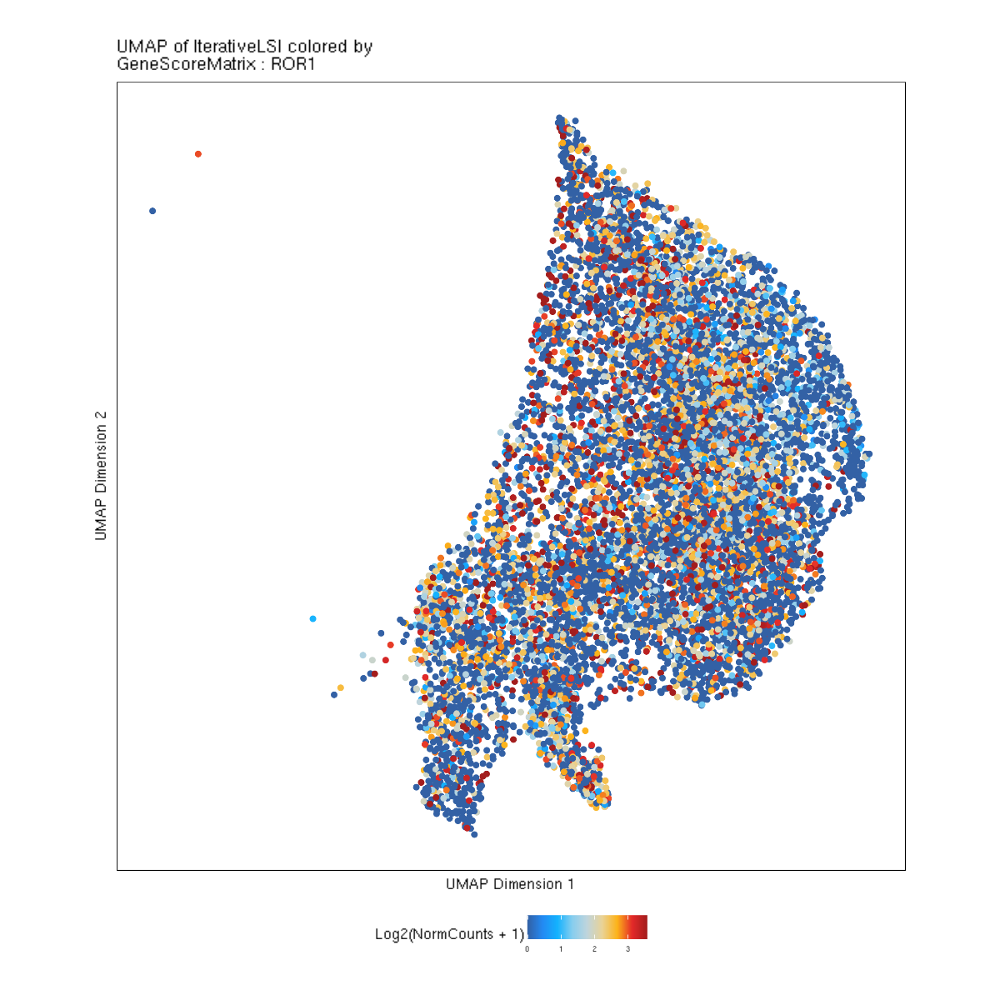

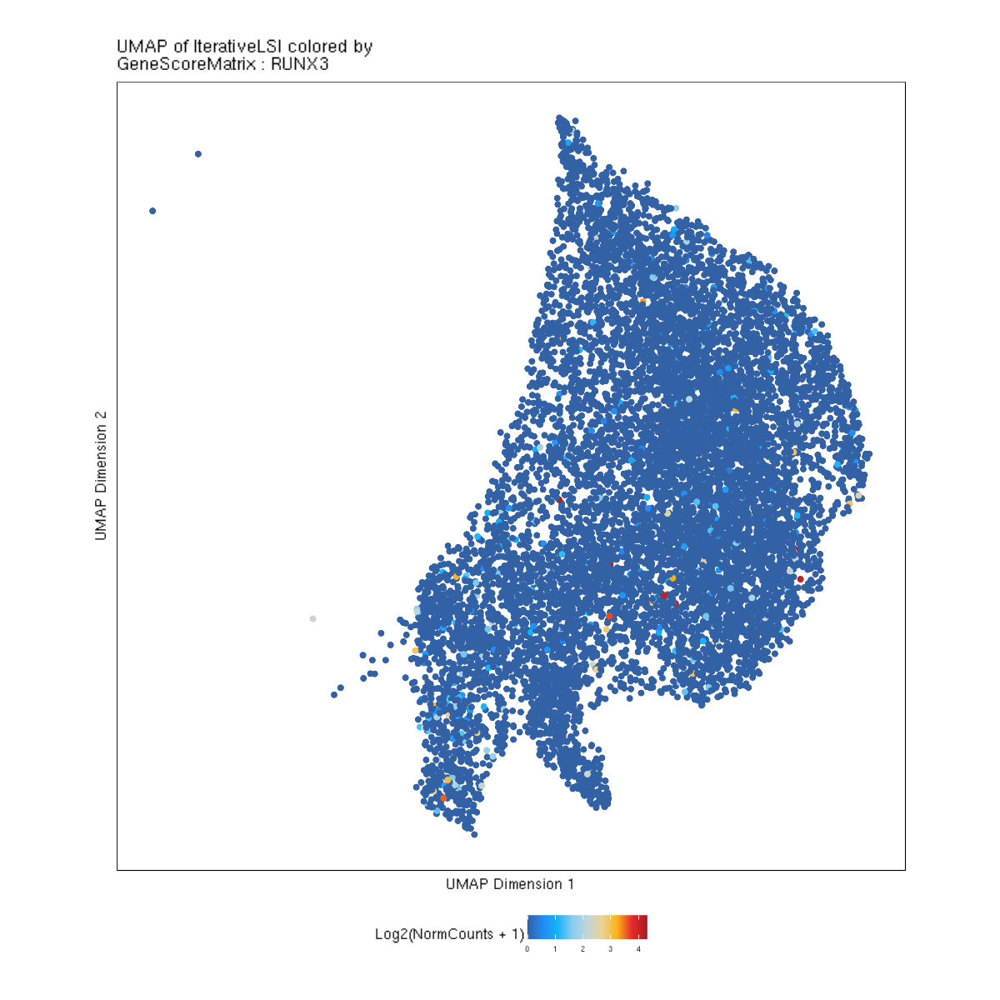

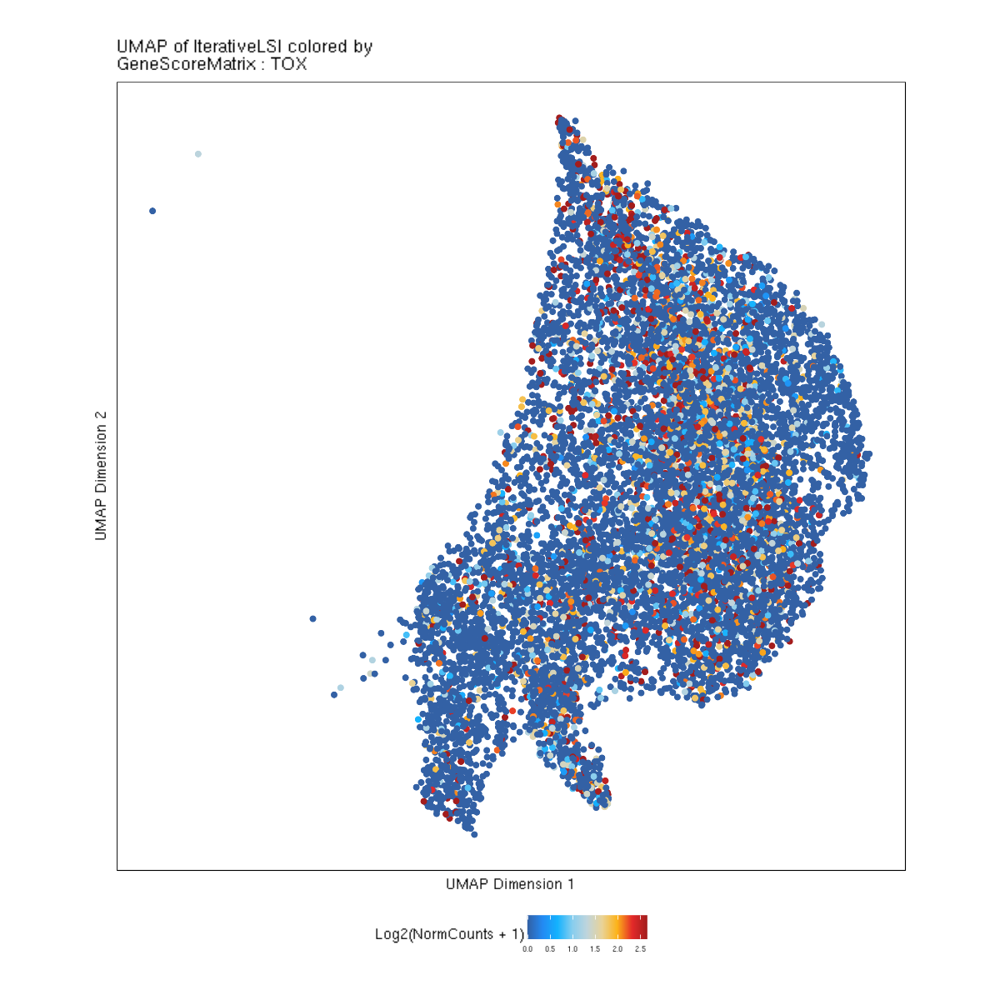

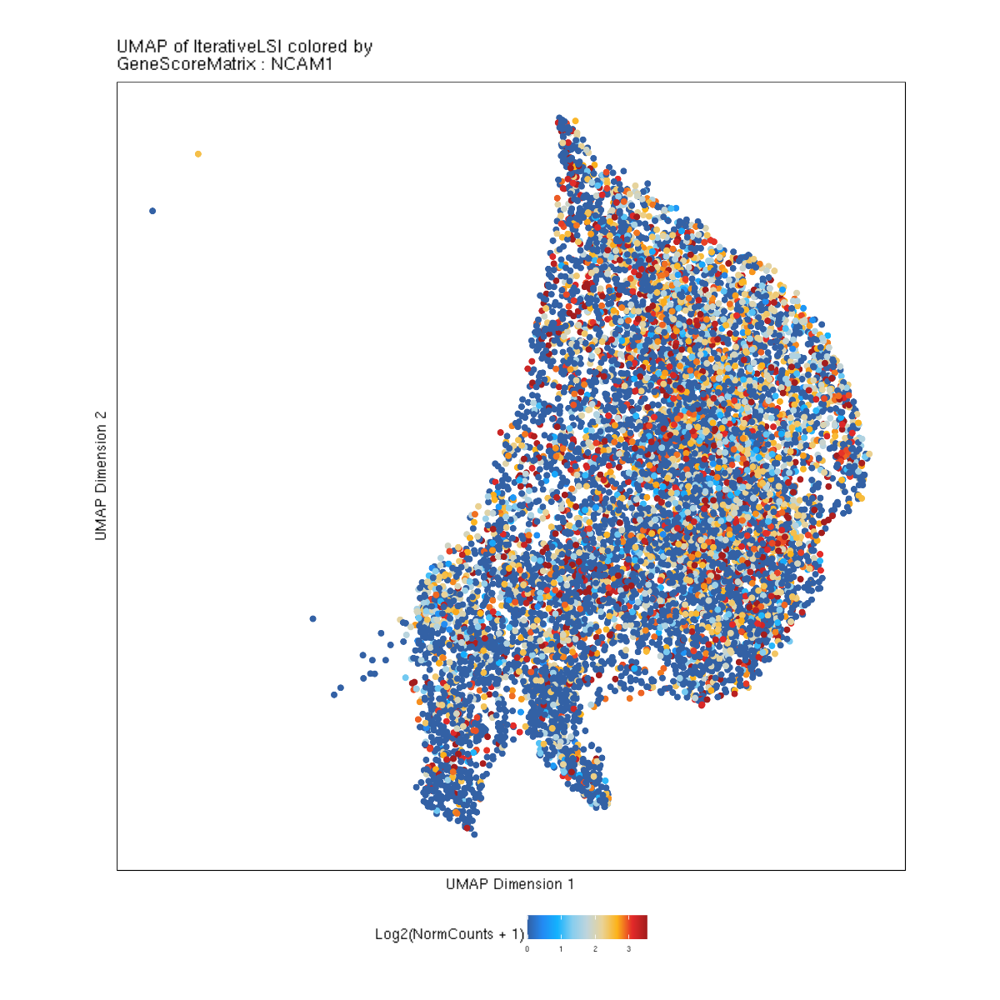

$EBF1

$PAX5

$SECISBP2L

$CCR6

$CD14

$FCGR3A

$LEF1

$CD4

$CD8A

$CD3D

$TBX21

$GATA3

$ROR1

$RUNX3

$TOX

$NCAM1

$NCAM2

$ITGAX


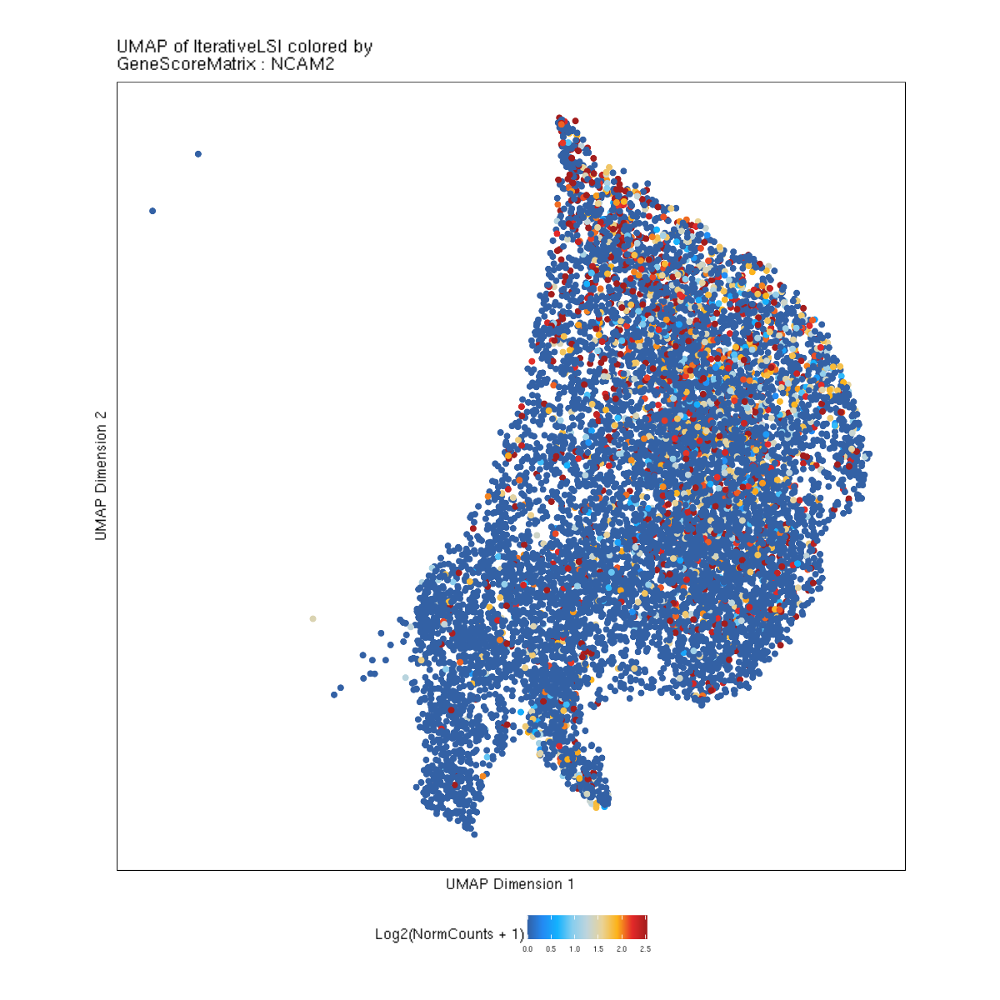

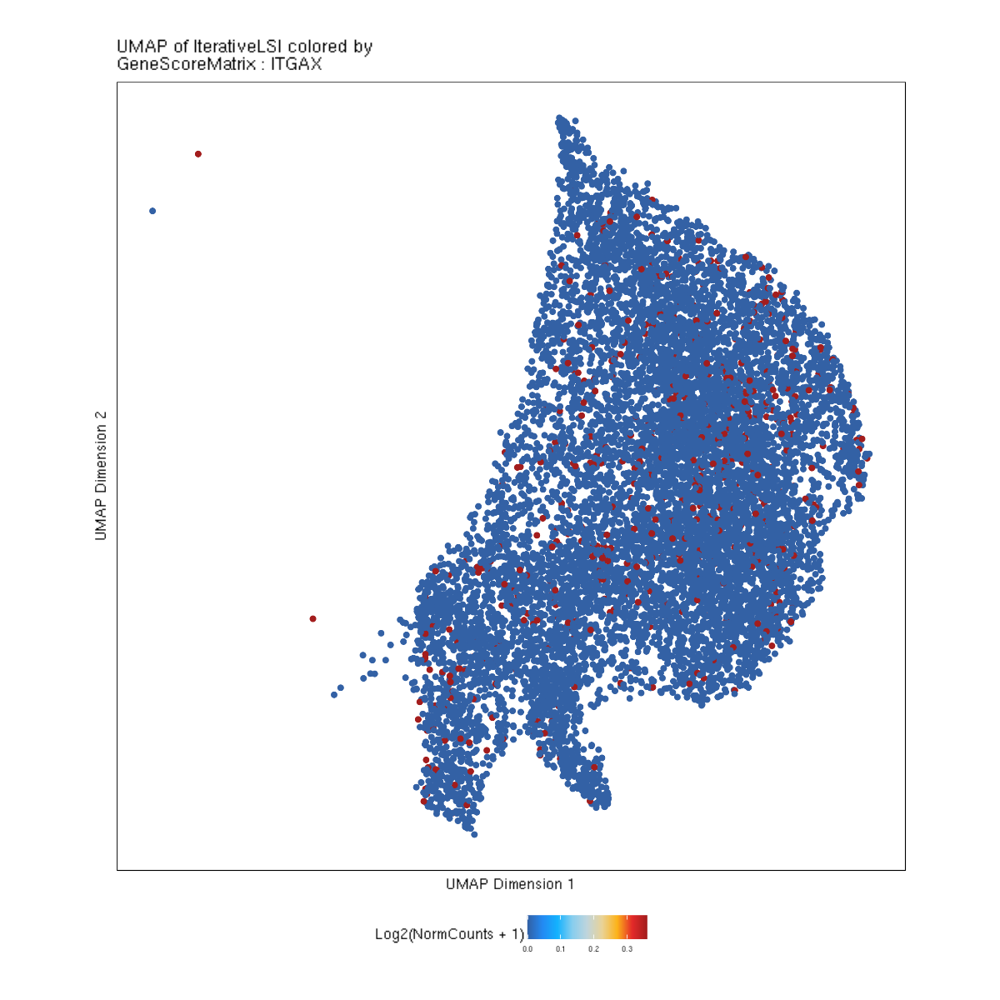

In [187]:
#raw counts
p1 = plotEmbedding(
        ArchRProj = proj1, 
        colorBy = "GeneScoreMatrix", 
        name = fin, 
        embedding = "UMAP",
        quantCut = c(0.01, 0.95),
        size =1, 
        pal= paletteContinuous(), 
        plotAs= "points", 
        imputeWeights = NULL
    #getImputeWeights(proj)
)

In [182]:
p1

NULL

In [17]:
#imputed counts
p2 = plotEmbedding(
        ArchRProj = proj1, 
        colorBy = "GeneScoreMatrix", 
        name = fin, 
        embedding = "UMAP",
        quantCut = c(0.01, 0.95),
        size =1, 
        pal= paletteContinuous(), 
        plotAs= "points", 
        imputeWeights = getImputeWeights(proj)
)

Getting ImputeWeights

ArchR logging to : ArchRLogs/ArchR-plotEmbedding-903433b456d-Date-2022-10-05_Time-17-31-00.log
If there is an issue, please report to github with logFile!

Getting UMAP Embedding

ColorBy = GeneScoreMatrix

Getting Matrix Values...

2022-10-05 17:31:02 : 

1 


Imputing Matrix

Using weights on disk

Using weights on disk

Using weights on disk

Using weights on disk

Using weights on disk

Plotting Embedding

1 
2 
3 
4 
5 
6 
7 
8 
9 
10 
11 
12 
13 
14 
15 
16 
17 
18 
19 
20 
21 
22 
23 


ArchR logging successful to : ArchRLogs/ArchR-plotEmbedding-903433b456d-Date-2022-10-05_Time-17-31-00.log



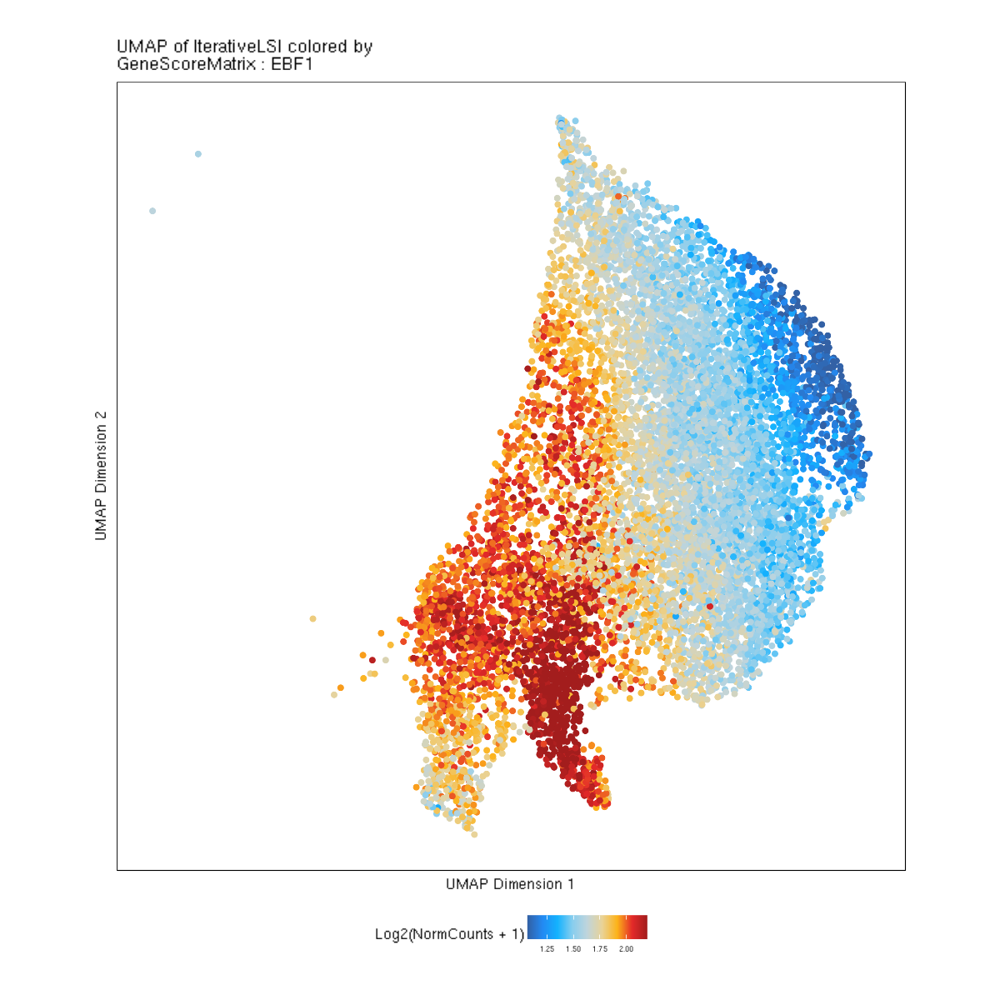

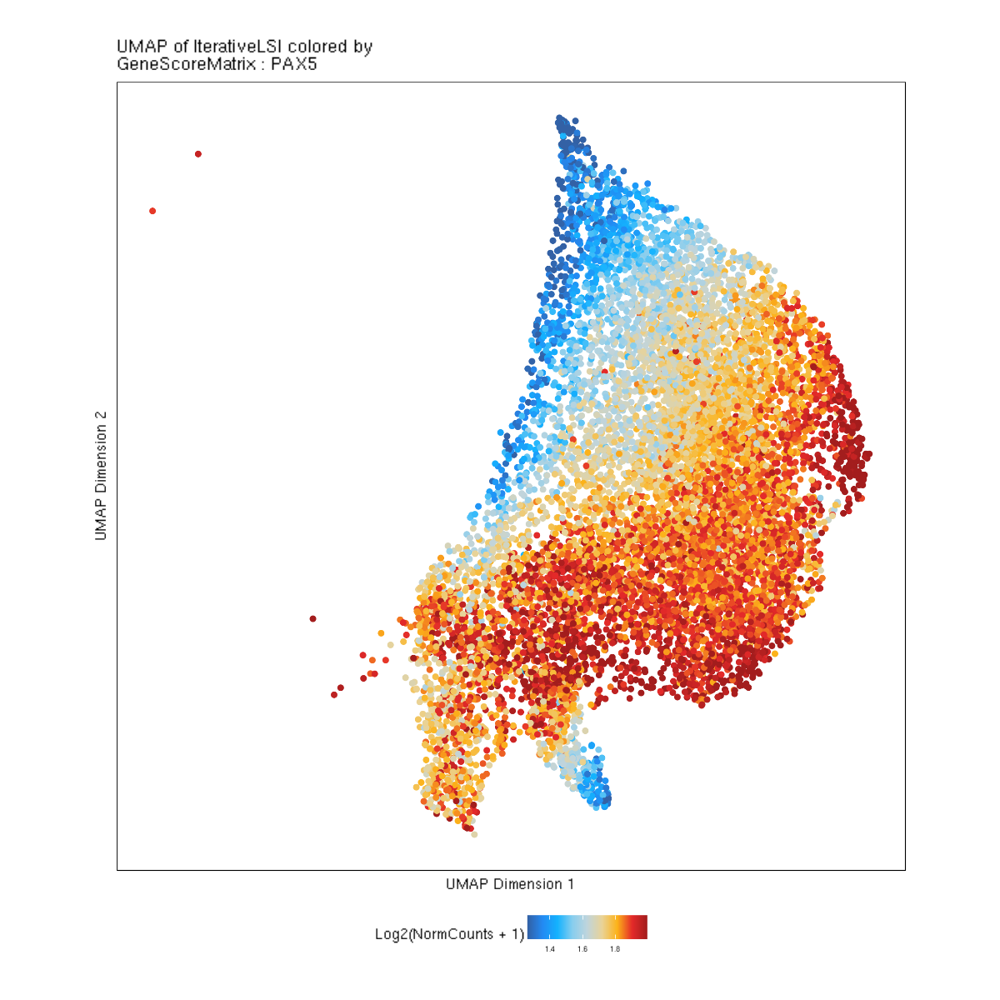

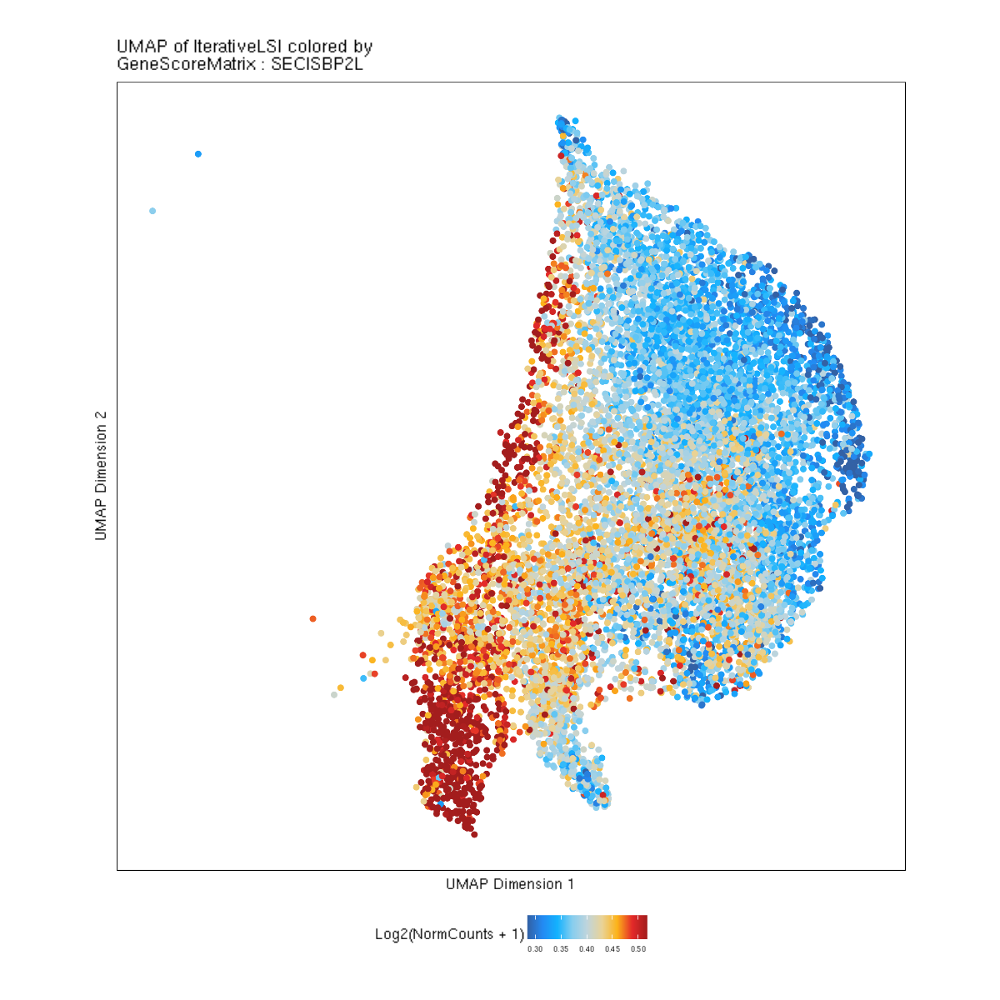

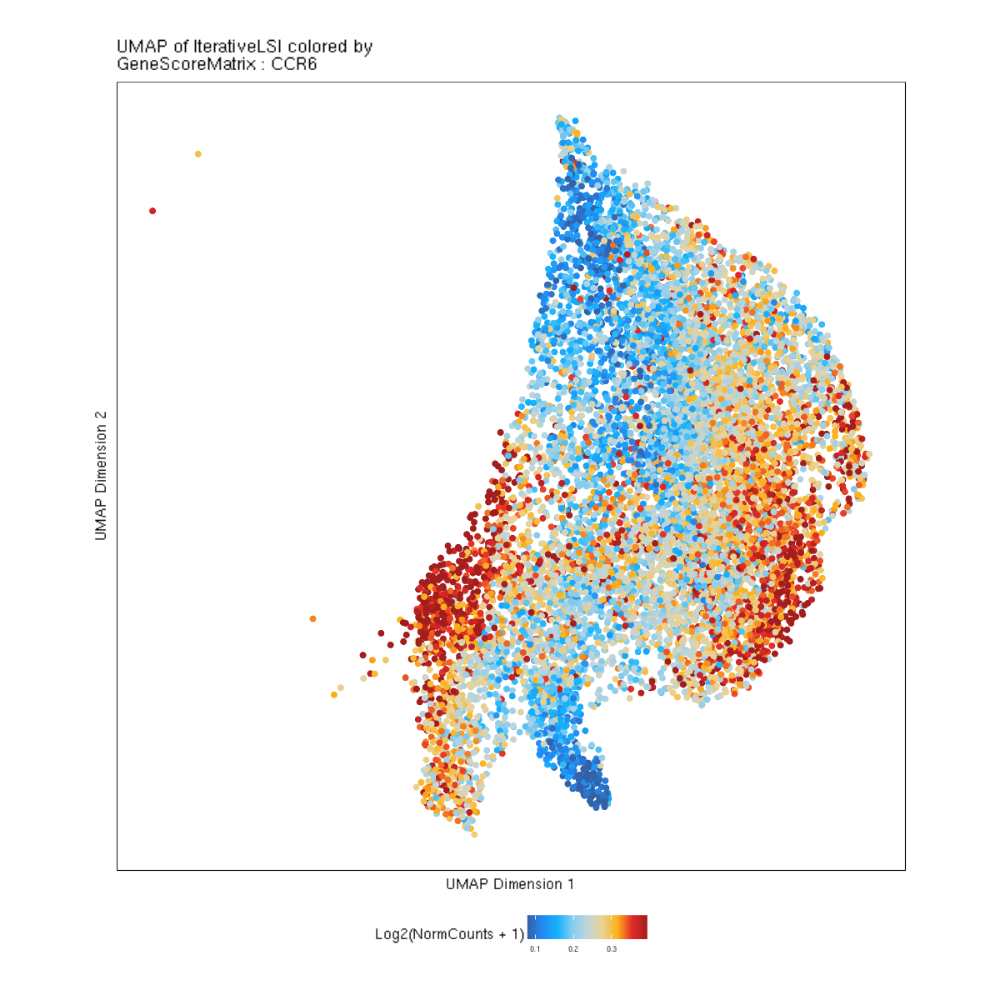

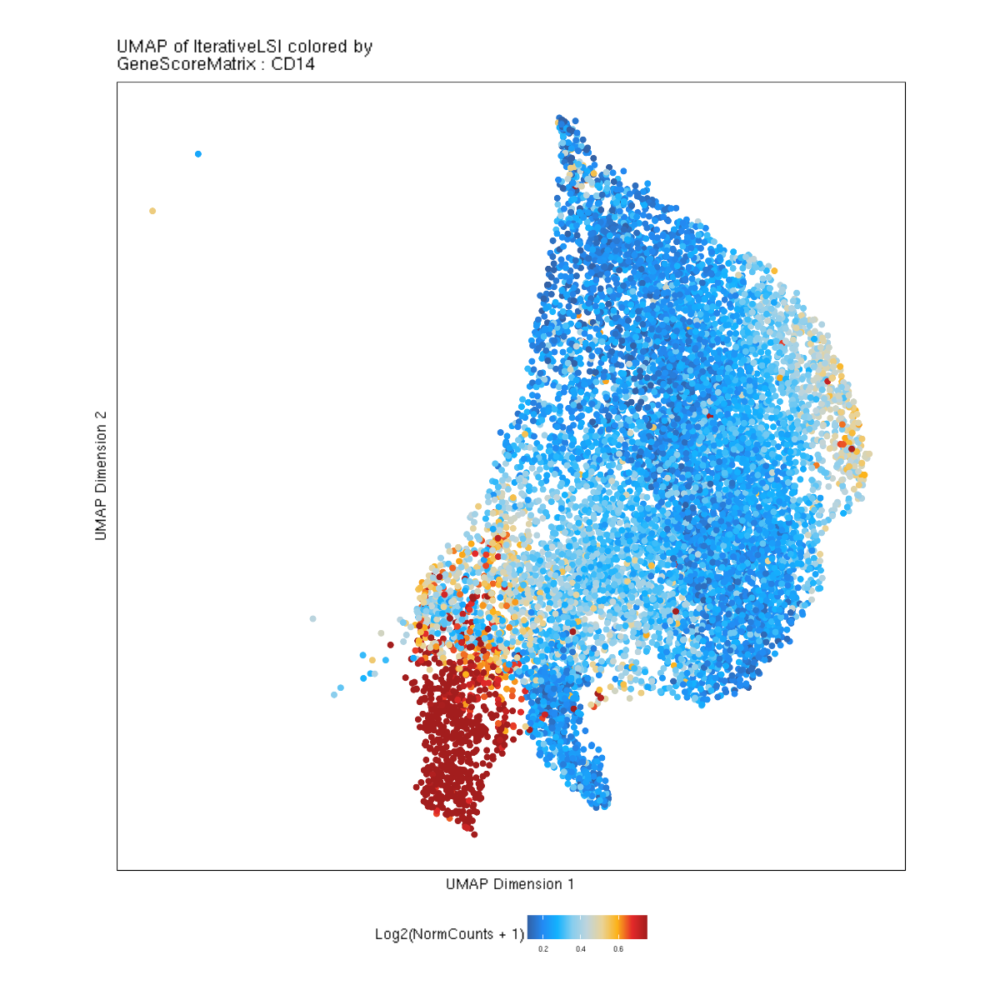

...

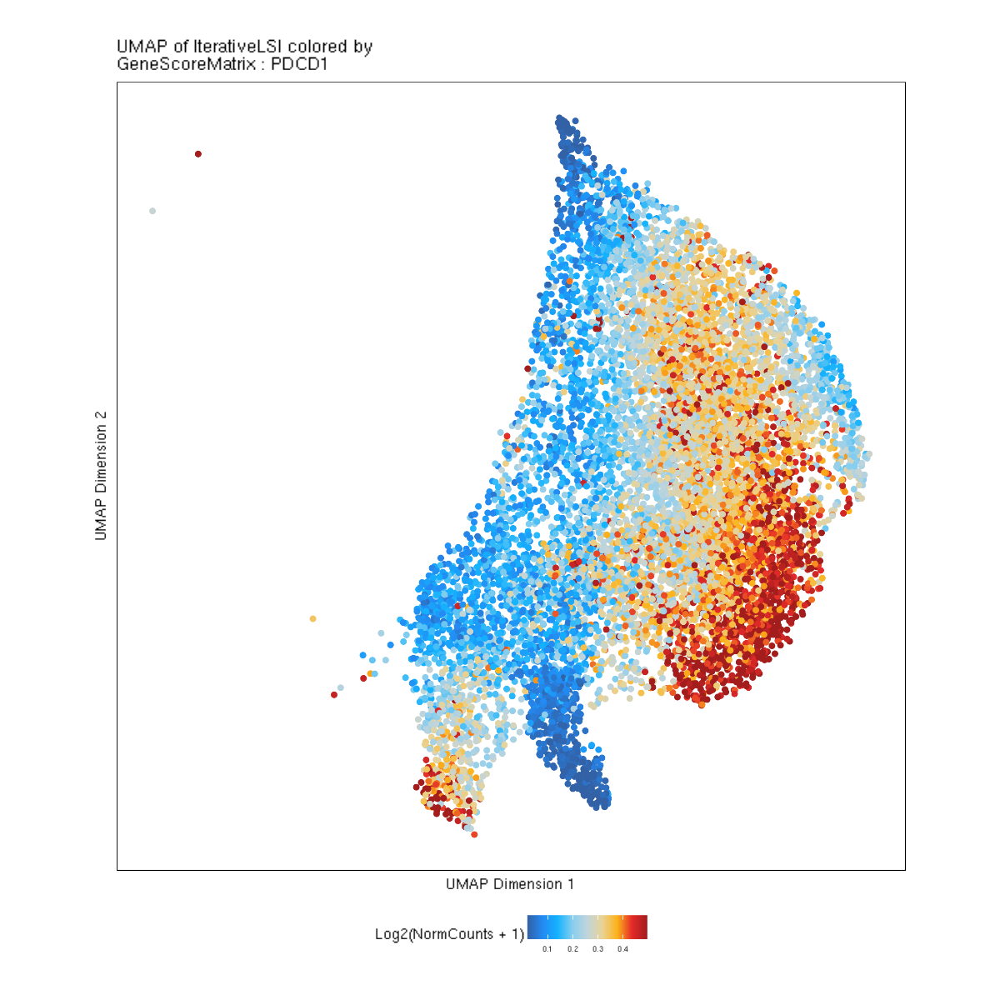

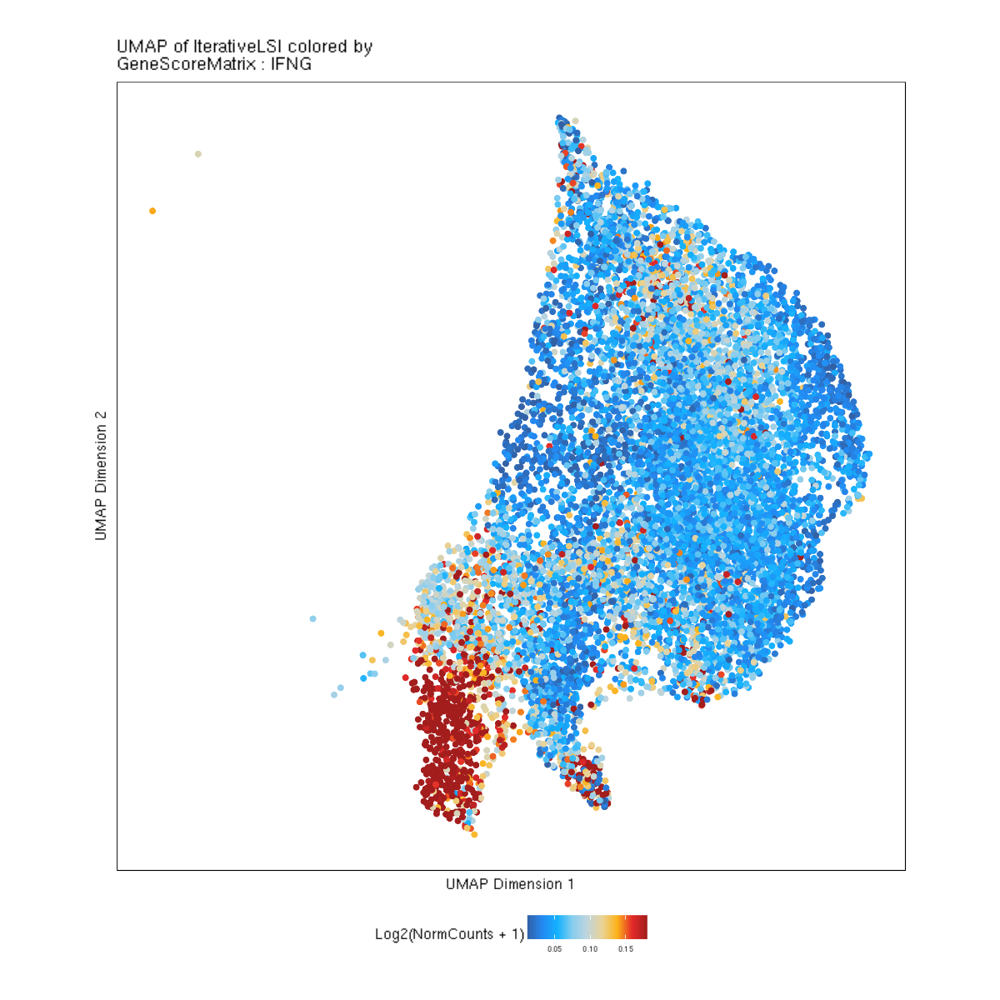

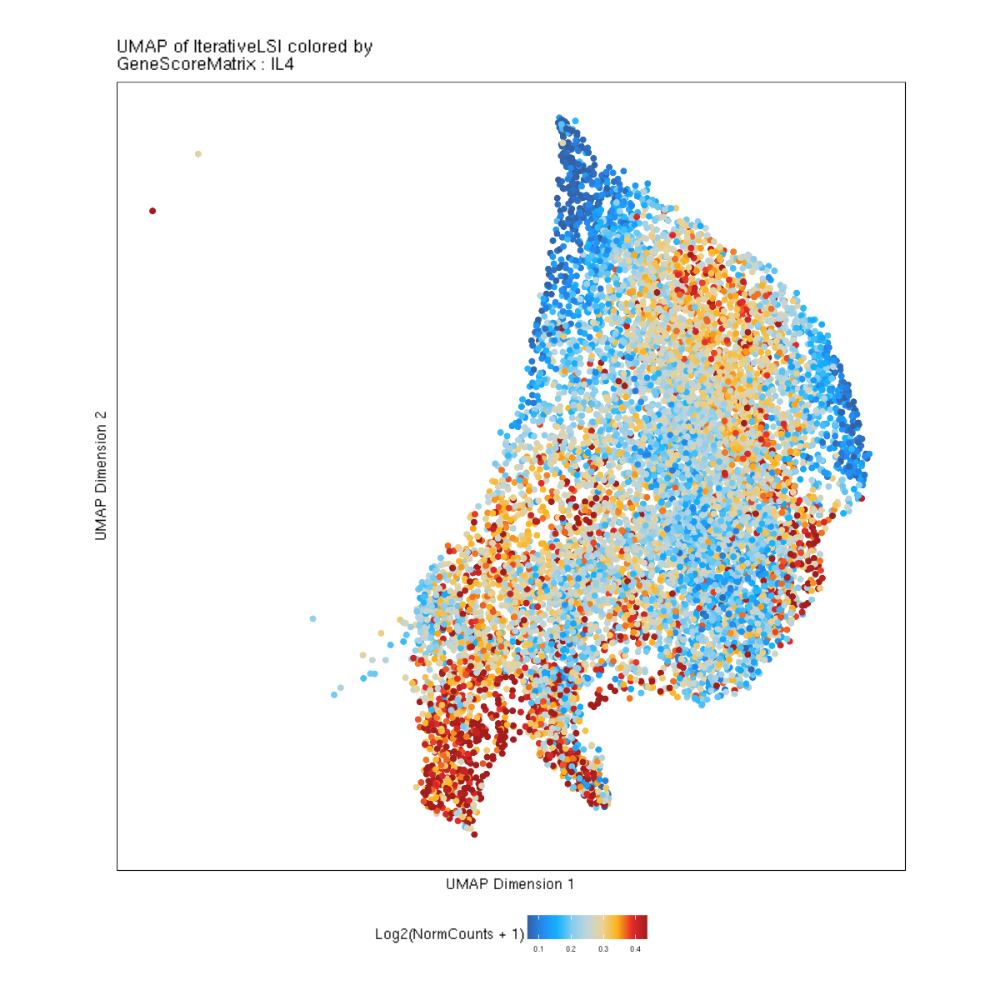

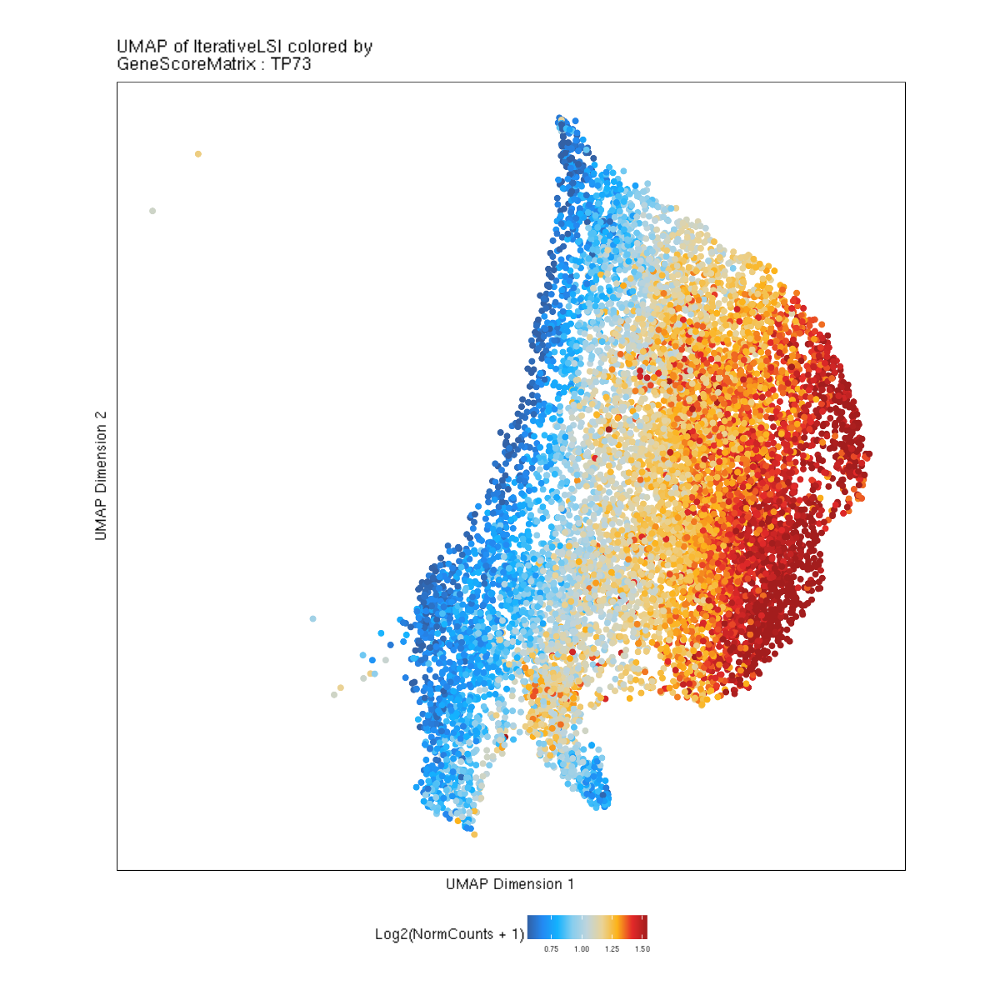

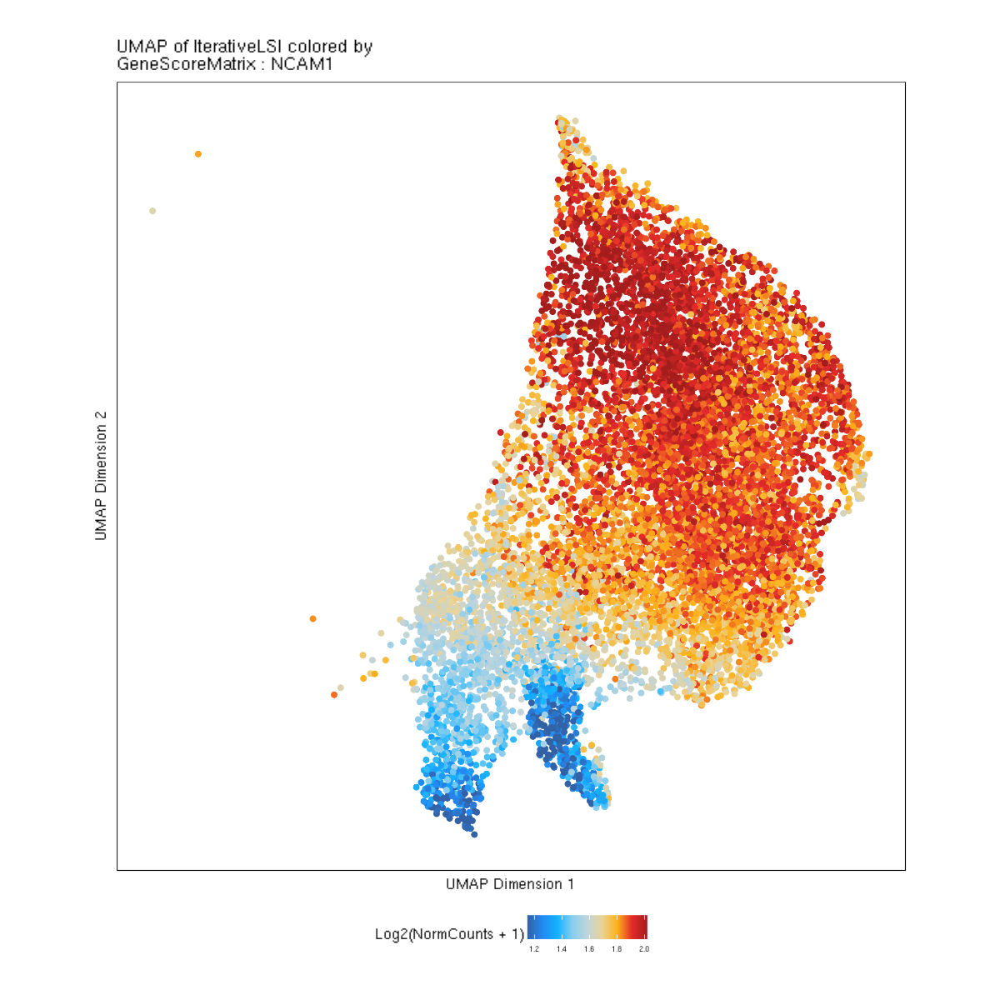

$EBF1

$PAX5

$SECISBP2L

$CCR6

$CD14

$FCGR3A

$LEF1

$CD4

$CD8A

$CD3D

$TBX21

$GATA3

$ROR1

$RUNX3

$TOX

$HAVCR2

$PDCD1

$IFNG

$IL4

$TP73

$NCAM1

$NCAM2

$ITGAX


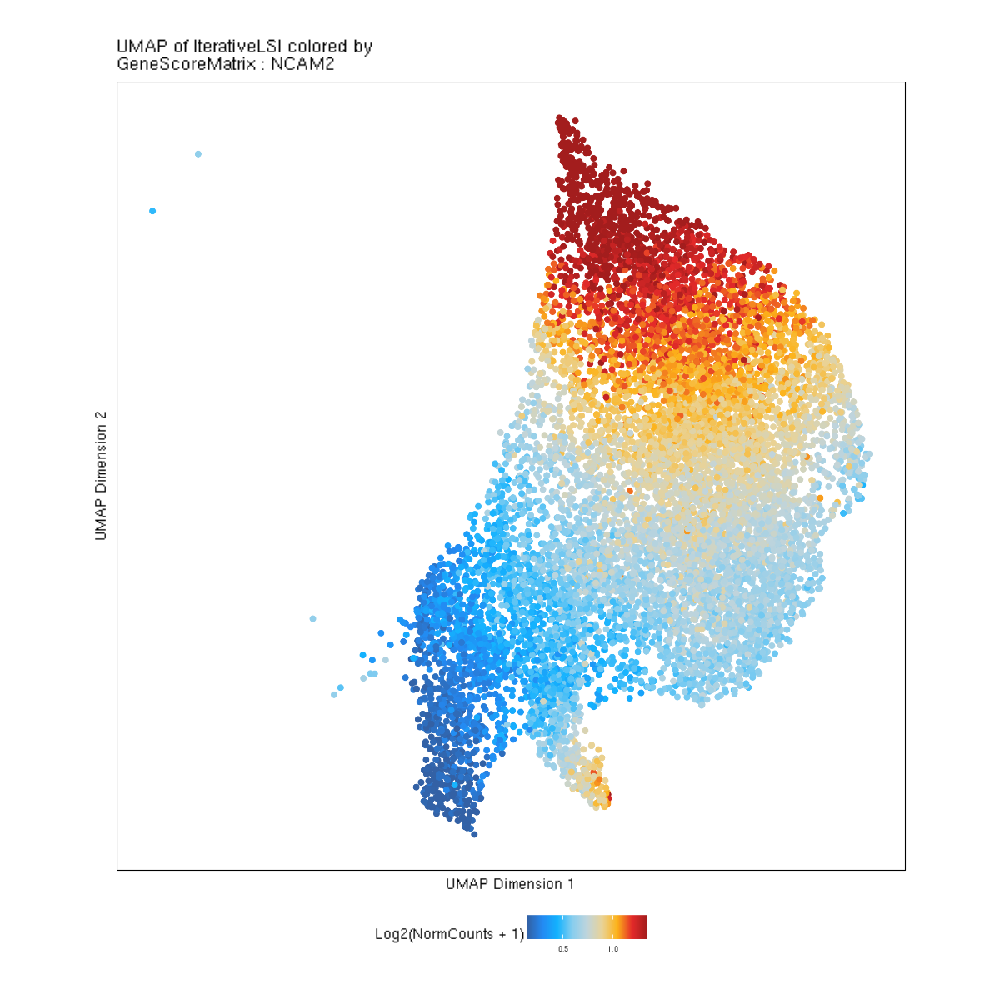

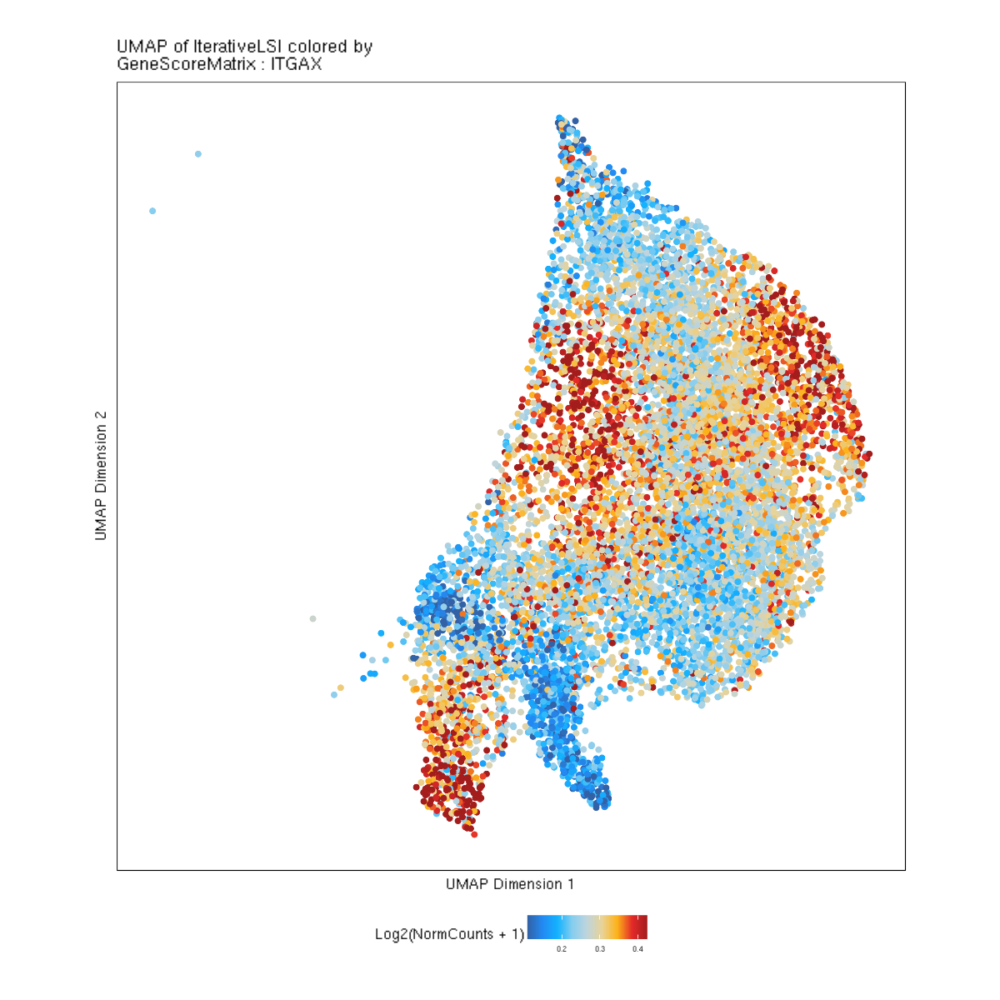

In [18]:
p2

ArchR logging to : ArchRLogs/ArchR-plotEmbedding-86976f8d356-Date-2022-10-06_Time-14-59-08.log
If there is an issue, please report to github with logFile!

Getting UMAP Embedding

ColorBy = GeneScoreMatrix

Getting Matrix Values...

2022-10-06 14:59:09 : 

1 


Plotting Embedding

1 


ArchR logging successful to : ArchRLogs/ArchR-plotEmbedding-86976f8d356-Date-2022-10-06_Time-14-59-08.log



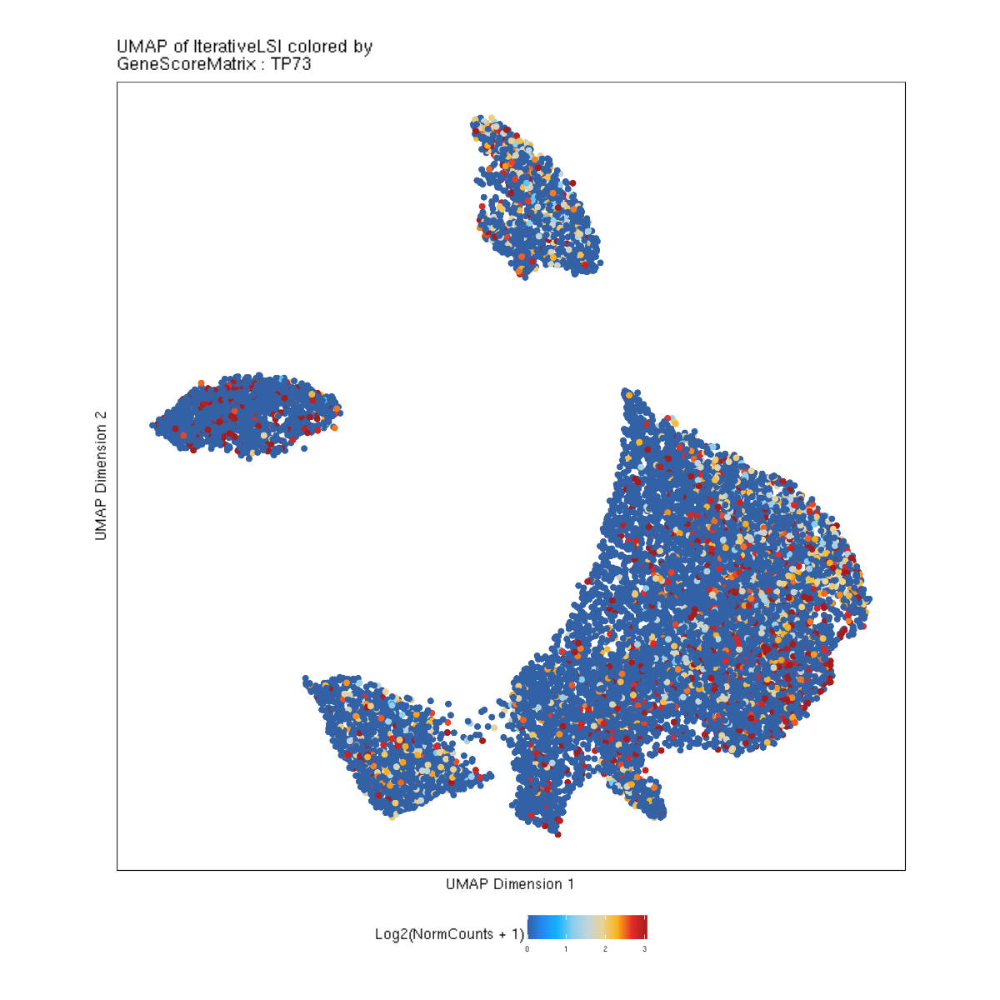

In [24]:
plotEmbedding(
        ArchRProj = proj, 
        colorBy = "GeneScoreMatrix", 
        name = 'TP73', 
        embedding = "UMAP",
        quantCut = c(0.01, 0.95),
        size =1, 
        pal= paletteContinuous(), 
        plotAs= "points", 
        imputeWeights = NULL#getImputeWeights(proj)
)

ArchR logging to : ArchRLogs/ArchR-plotMarkerHeatmap-54fa6a2b0879-Date-2022-10-17_Time-14-42-29.log
If there is an issue, please report to github with logFile!

Printing Top Marker Genes:

B Mem:

	ATAD3C, MEGF6, MIR551A, TPRG1L, ACOT11, IL23R, NEGR1, LOC101927434, GBP6, RPAP2, DPYD-AS1, ATP1B1, COLGALT2, LINC01720, MIR181A1HG

B Naive:

	LINC01714, FAM131C, MINOS1-NBL1, NBL1, UBXN10, HIVEP3, SLC1A7, LEXM, DHCR24, WLS, PLPPR5, GPR88, OLFML3, TRIM33, MAB21L3

Mono:

	LINC02593, SAMD11, PLEKHN1, AGRN, RNF223, TTLL10, TNFRSF18, TNFRSF4, DVL1, MIR6808, MXRA8, VWA1, TMEM240, MMP23B, MMP23A

NK:

	FAAP20, RERE, RERE-AS1, ENO1-AS1, CA6, SLC25A33, LOC284632, STPG1, NIPAL3, RCAN3, LOC100506985, NCMAP, PDIK1L, FAM110D, CRYBG2

T Mem:

	HSPG2, MIR101-1, AK4, SERBP1, ST6GALNAC3, SAMD13, EVI5, BCAR3, LINC01307, GSTM4, LINC01525, RALGPS2, CRB1, LEMD1-AS1, YOD1

T Naive:

	TTC34, LINC01777, PRAMEF27, IGSF21, AGBL4, C8A, LINC00466, PDE4B, LRRIQ3, MGC27382, PTGFR, ADGRL4, LINC01361, LINC01787, LINC0170

 [1] "EBF1"      "PAX5"      "SECISBP2L" "CCR6"      "CD14"      "FCGR3A"   
 [7] "LEF1"      "CD4"       "CD8A"      "CD3D"      "TBX21"     "GATA3"    
[13] "ROR1"      "RUNX3"     "IFNG"      "IL4"       "TP73"      "NCAM1"    
[19] "NCAM2"     "ITGAX"    


Preparing Main Heatmap..

ArchR logging successful to : ArchRLogs/ArchR-plotMarkerHeatmap-54fa6a2b0879-Date-2022-10-17_Time-14-42-29.log



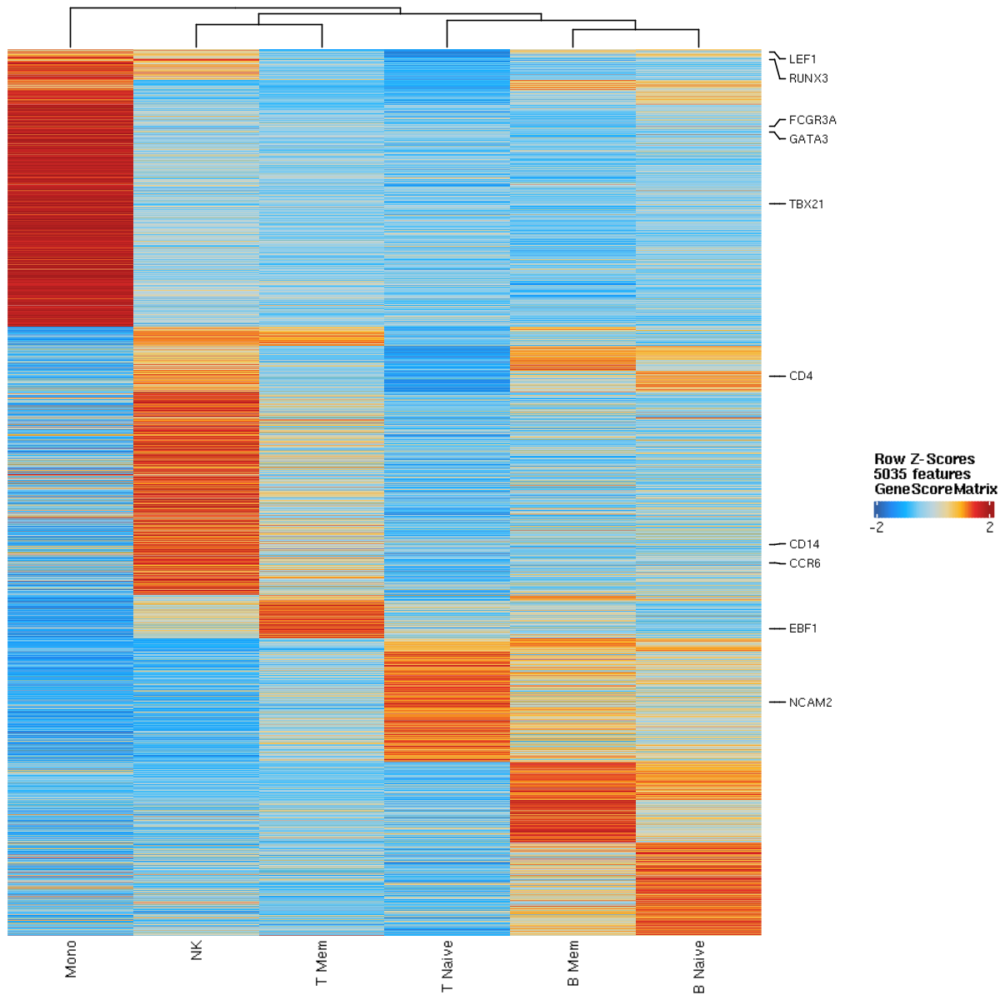

In [135]:
p0 = plotMarkerHeatmap(
  seMarker = markersGS,
  cutOff = "FDR <= 0.01 & Log2FC >= 0.5",
  log2Norm = TRUE,
  scaleTo = 10^4,
  scaleRows = TRUE,
  plotLog2FC = FALSE,
  limits = c(-2, 2),
  grepExclude = NULL,
  pal = paletteContinuous(),
  binaryClusterRows = TRUE,
  clusterCols = TRUE,
  labelMarkers = fin,
  nLabel = 15,
  nPrint = 15,
  labelRows = FALSE,
  returnMatrix = FALSE,
  transpose = FALSE,
  invert = FALSE,
  logFile = createLogFile("plotMarkerHeatmap")
)
p0

In [136]:
plot_dir = '/fh/fast/henikoff_s/user/jgreene/projects/sciCnT/data/Figures/'
pdf(file=paste0(plot_dir, '221017_PBMC_K27me3_genemap_up.pdf'),width=10, height=10)
p0
dev.off()

png 
  2

In [152]:
proj
mean(proj$nFrags)


           ___      .______        ______  __    __  .______      
          /   \     |   _  \      /      ||  |  |  | |   _  \     
         /  ^  \    |  |_)  |    |  ,----'|  |__|  | |  |_)  |    
        /  /_\  \   |      /     |  |     |   __   | |      /     
       /  _____  \  |  |\  \\___ |  `----.|  |  |  | |  |\  \\___.
      /__/     \__\ | _| `._____| \______||__|  |__| | _| `._____|
    



class: ArchRProject 
outputDirectory: /fh/fast/henikoff_s/user/jgreene/projects/sciCnT/data/ArchR/DJ_Hs_PBMC_K27me3_220523_220527_79x79_MERGE_50k/proj_FINAL 
samples(1): DJ_Hs_PBMC_K27me3_ALLSEQ_220523_220527
sampleColData names(1): ArrowFiles
cellColData names(34): Sample TSSEnrichment ... T-8 LLbean
numberOfCells(1): 14984
medianTSS(1): 1.411
medianFrags(1): 2116

[1] 2649.034

ArchR logging to : ArchRLogs/ArchR-plotMarkerHeatmap-54fa30e9feba-Date-2022-10-17_Time-15-06-23.log
If there is an issue, please report to github with logFile!

Printing Top Marker Genes:

B Mem:

	WRAP73, LINC01346, RBP7, NECAP2, KLHDC7A, PLA2G2A, LINC01141, SH2D5, ECE1, WNT4, ID3, CLIC4, EYA3, MIR4420, ZSCAN20

B Naive:

	SLC2A5, CNR2, IFNLR1, SCMH1, FOXO6, VAV3-AS1, GPSM2, RHOC, SPTA1, TIPRL, FMO2, FMO1, SMG7, SYT2, CYB5R1

Mono:

	LINC01777, PADI2, PADI4, PHC2, LOC101929464, CSMD2, EBNA1BP2, KLF17, RNF220, TMEM53, AGBL4, DAB1, LOC101926964, NFIA, TM2D1

NK:

	UTS2, TNFRSF9, MAD2L2, DRAXIN, FHAD1, LINC01389, AGBL4-IT1, C8A, GNG12-AS1, WLS, DEPDC1-AS1, LRRC7, ZRANB2-AS2, TYW3, LOC101927342

T Mem:

	PRDM16, GPR153, ACTL8, PBX1, GREM2, OR1C1, NEBL, RASGEF1A, DKK1, LNCAROD, MBL2, LINC01514, SORCS1, PLPP4, HTRA1

T Naive:

	AGRN, ESPN, TNFRSF25, PLEKHG5, ERRFI1, ENO1-AS1, CA6, SPSB1, SLC25A33, DHRS3, EPHA2, IFFO2, HTR6, UBXN10, CELA3B

Identified 5079 markers!



 [1] "EBF1"      "PAX5"      "SECISBP2L" "CCR6"      "FCGR3A"    "CEBPA"    
 [7] "CEBPB"     "LEF1"      "CD4"       "CD8A"      "CD3D"      "TBX21"    
[13] "GATA3"     "RUNX3"     "IFNG"      "IL4"       "TP73"      "NCAM1"    
[19] "NCAM2"    


Preparing Main Heatmap..

ArchR logging successful to : ArchRLogs/ArchR-plotMarkerHeatmap-54fa30e9feba-Date-2022-10-17_Time-15-06-23.log



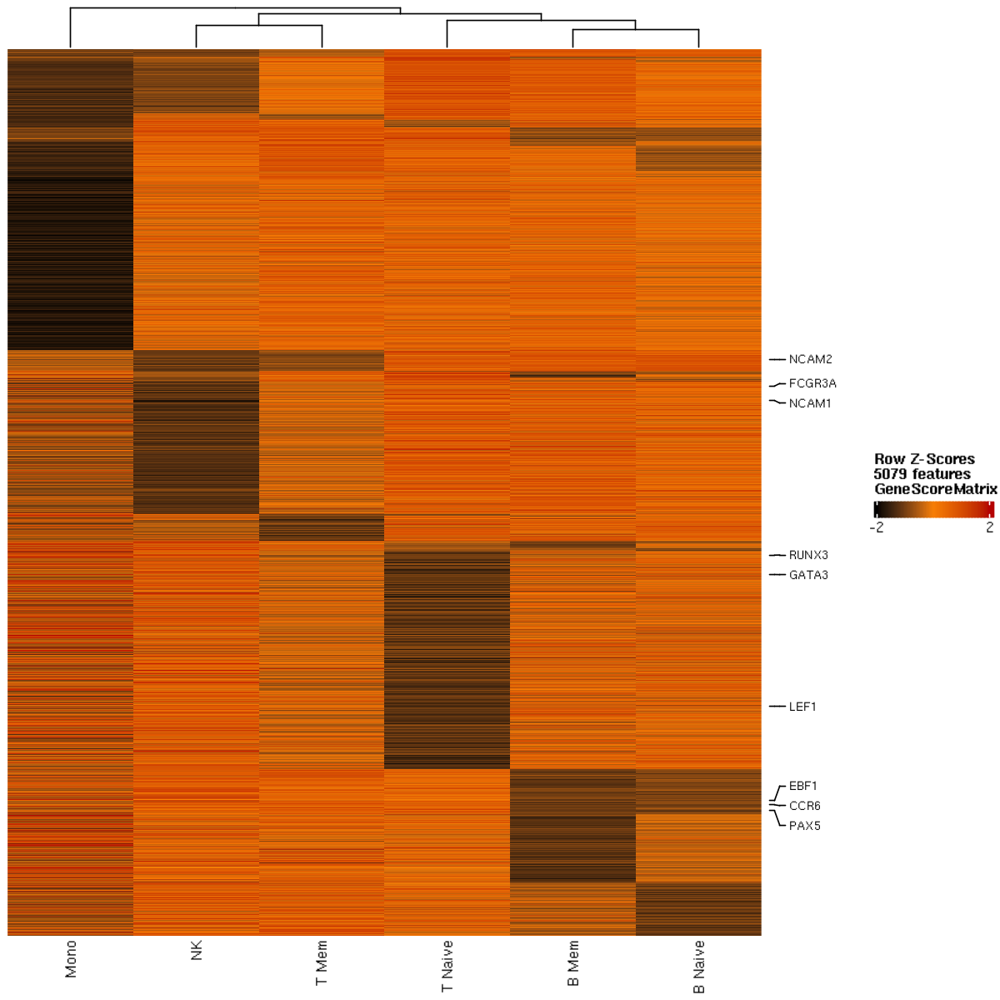

In [147]:
p1 = plotMarkerHeatmap(
  seMarker = markersGS,
  cutOff = "FDR <= 0.01 & Log2FC <= -0.5",
  log2Norm = TRUE,
  scaleTo = 10^4,
  scaleRows = TRUE,
  plotLog2FC = FALSE,
  limits = c(-2, 2),
  grepExclude = NULL,
  pal = c("3"="black","2"="#f77e05", "1"="#b50202"),
  binaryClusterRows = TRUE,
  clusterCols = TRUE,
  labelMarkers = fin,
  nLabel = 15,
  nPrint = 15,
  labelRows = FALSE,
  returnMatrix = FALSE,
  transpose = FALSE,
  invert = FALSE,
  logFile = createLogFile("plotMarkerHeatmap")
)
p1

In [148]:
plot_dir = '/fh/fast/henikoff_s/user/jgreene/projects/sciCnT/data/Figures/'
pdf(file=paste0(plot_dir, '221017_PBMC_K27me3_genemap_down.pdf'),width=10, height=10)
p1
dev.off()

png 
  2